In [4]:
%matplotlib inline
import numpy as np

In [3]:
def solve_spectrum(sbm=None, psi=None, pi=None, p_reciprocate=1., factor=1e-1, tol=1e-15, init=1., use_jacobian=False, nbins=1000):
    import numpy as np
    from scipy.optimize import fsolve
    import matplotlib.pyplot as plt
    
    if sbm is not None:
        psi = (sbm['psi']+p_reciprocate*sbm['psi'].T)/2
        cov = p_reciprocate*(sbm['psi']+sbm['psi'].T)/2
        pi = sbm['pi']

    m = len(psi)
    
    def foo(x, z):
        a = x[:m]
        b = x[m:]
        return np.hstack([a*np.dot(cov, a) - b*np.dot(cov, b) - z*a + pi, b*np.dot(cov, a) + a*np.dot(cov, b) - z*b])
    
    def foo1(x, z):
        a = x[:m]
        b = x[m:]
        c, d = z[0], z[1]
        return np.hstack([a*np.dot(cov, a) - b*np.dot(cov, b) - c*a + d*b + pi, b*np.dot(cov, a) + a*np.dot(cov, b) - c*b - d*a])
    
    def foo_jacobian(x, z):
        a = x[:m]
        b = x[m:]
        r_a = np.diag(np.dot(psi, a)) + a[:,np.newaxis]*psi - z
        r_b = - np.diag(np.dot(psi, b)) - b[:,np.newaxis]*psi
        return np.vstack([np.hstack([r_a, r_b]), np.hstack([-r_b, r_a])])
    
    def rad(z, r):
        g_z = sum(fsolve(foo, factor*np.ones(2*m), args=z, xtol=tol)[:m])
        return r*g_z-1
    
    def rad1(z, r):
        g_z = sum(fsolve(foo1, factor*np.ones(2*m), args=z, xtol=tol)[:m])
        return r*g_z-1, z[1]
    
    mat = (pi[:,np.newaxis]**0.5)*psi*(pi[np.newaxis,:]**0.5)
    if p_reciprocate==1: radius = np.max(np.linalg.eigvalsh(mat))
    else: radius = np.max(np.real(np.linalg.eigvals(mat)))
    #e_radius = fsolve(rad1, [radius, 0], args=radius, xtol=tol)[0]
    e_radius = fsolve(rad, radius+init, args=radius, xtol=tol)[0]
    lim = (-max(radius, e_radius), max(radius, e_radius)+1)
    z_s = np.linspace(lim[0], lim[1], nbins)
    rho = []
    if use_jacobian:
        for z in z_s:
            if z<=0: rho.append(-sum(fsolve(foo, -factor*np.ones(2*m), args=z, fprime=foo_jacobian, xtol=tol)[m:])/np.pi)
            else: rho.append(sum(fsolve(foo, factor*np.ones(2*m), args=z, fprime=foo_jacobian, xtol=tol)[m:])/np.pi)
    else:
        for z in z_s:
            if z<=0: rho.append(-sum(fsolve(foo, -factor*np.ones(2*m), args=z, xtol=tol)[m:])/np.pi)
            else: rho.append(sum(fsolve(foo, factor*np.ones(2*m), args=z, xtol=tol)[m:])/np.pi)
    plt.plot(z_s, np.abs(rho), label='spectral density')
    plt.gca().axvline(radius, ls='-', c='red', label='$\\rho$(E[A])')
    plt.gca().axvline(e_radius, ls='--', c='black', label='E[$\\rho$(A)]')
    plt.xlabel('$\\lambda$')
    plt.ylabel('p($\\lambda$)')
    plt.legend(bbox_to_anchor=(1.02, 1.0), loc='upper left')
    plt.show()
    return z_s, rho, e_radius

In [11]:
def solve_spectrum_reci(sbm=None, psi=None, pi=None, p_reciprocate=0., factor=1e-1, tol=1e-15, init=[1., 0.], nbins=100):
    import numpy as np
    from scipy.optimize import fsolve
    import matplotlib.pyplot as plt
    
    if sbm is not None:
        psi = (sbm['psi']+p_reciprocate*sbm['psi'].T)/2
        cov = p_reciprocate*(sbm['psi']+sbm['psi'].T)/2
        pi = sbm['pi']

    m = len(psi)
    
    def foo(x, z):
        a = x[:m]
        b = x[m:]
        c, d = z[0], z[1]
        return np.hstack([a*np.dot(cov, a) - b*np.dot(cov, b) - c*a + d*b + pi, b*np.dot(cov, a) + a*np.dot(cov, b) - c*b - d*a])
    
    def rad(z, r):
        g_z = sum(fsolve(foo, factor*np.ones(2*m), args=z, xtol=tol)[:m])
        return r*g_z-1, z[1]
    
    mat = (pi[:,np.newaxis]**0.5)*psi*(pi[np.newaxis,:]**0.5)
    if p_reciprocate==1: radius = np.max(np.linalg.eigvalsh(mat))
    else: radius = np.max(np.real(np.linalg.eigvals(mat)))
    e_radius = fsolve(rad, [init[0]+radius, init[1]], args=radius, xtol=tol)[0]
    lim = (-(max(radius, e_radius)+1), max(radius, e_radius)+1)
    z_all = np.meshgrid(*[np.linspace(lim[0], lim[1], nbins)]*2, indexing='ij')
    z_s = np.vstack([z_all[0].flatten(), z_all[1].flatten()]).T
    rho = []
    for z in z_s:
        g_curr = fsolve(foo, factor*np.ones(2*m), args=z, xtol=tol)
        rho.append(np.abs(np.sum((g_curr[:m] + 1j*g_curr[m:])**2/pi))/np.pi)
        #print(z, g_curr, rho[-1])
    rho = np.array(rho).reshape((nbins, nbins)).T
    plt.contourf(z_all[0], z_all[1], rho, label='spectral density')
    plt.gca().axvline(radius, ls='-', c='red', label='$\\rho$(E[A])')
    plt.gca().axvline(e_radius, ls='--', c='black', label='E[$\\rho$(A)]')
    plt.xlabel('re($\\lambda$)')
    plt.ylabel('im($\\lambda$)')
    plt.legend(bbox_to_anchor=(1.22, 1.0), loc='upper left')
    plt.colorbar()
    plt.show()
    return z_s, rho, e_radius

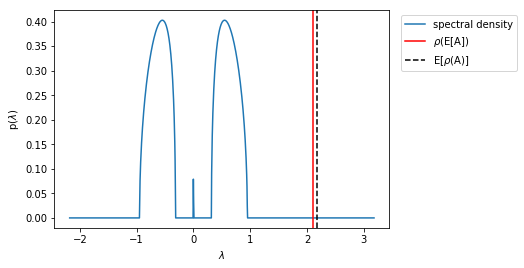

In [41]:
sbm_dum_sol = solve_spectrum(sbm_dummy, p_reciprocate=0.01)

In [1714]:
def solve_spectrum_laplacian(sbm=None, psi=None, pi=None, factor=1e-1, tol=1e-15, init=1., nbins=1000):
    import numpy as np
    from scipy.optimize import fsolve
    import matplotlib.pyplot as plt
    
    if sbm is not None:
        psi = sbm['psi']
        pi = sbm['pi']

    m = len(psi)
    
    def foo(x, z):
        a = x[:m]
        b = x[m:]
        #return np.hstack([(a**2-b**2)*np.dot(psi, pi) + a*np.dot(psi, a) - b*np.dot(psi, b) - z*a + pi, 2*a*b*np.dot(psi, pi) + b*np.dot(psi, a) + a*np.dot(psi, b) - z*b])
        return np.hstack([a*np.dot(psi, a) - b*np.dot(psi, b) - z*np.dot(psi, pi)*a + pi, b*np.dot(psi, a) + a*np.dot(psi, b) - z*np.dot(psi, pi)*b])
    
    def rad(z, r):
        g_z = sum(fsolve(foo, factor*np.ones(2*m), args=z, xtol=tol)[:m])
        return r*g_z-1
    
    lap = np.diag((1/pi) * np.dot(psi, pi)) - psi
    radius = np.sort(np.linalg.eigvalsh((pi[:,np.newaxis])**0.5*lap*pi[np.newaxis,:]**0.5))
    print(radius)
    fiedler = radius[1]
    e_fiedler = fsolve(rad, fiedler+init, args=fiedler, xtol=tol)[0]
    lim = (-max(radius), max(radius)+1)
    z_s = np.linspace(lim[0], lim[1], nbins)
    rho = []
    for z in z_s:
        if z<=0: rho.append(-sum(fsolve(foo, -factor*np.ones(2*m), args=z, xtol=tol)[m:])/np.pi)
        else: rho.append(sum(fsolve(foo, factor*np.ones(2*m), args=z, xtol=tol)[m:])/np.pi)
    plt.plot(z_s, rho, label='spectral density')
    plt.gca().axvline(fiedler, ls='-', c='red', label='$\\phi$(E[L])')
    plt.gca().axvline(e_fiedler, ls='--', c='black', label='E[$\\phi$(L)]')
    plt.xlabel('$\\lambda$')
    plt.ylabel('p($\\lambda$)')
    plt.legend(bbox_to_anchor=(1.02, 1.0), loc='upper left')
    plt.show()
    return z_s, rho, e_fiedler

In [1680]:
def plot_specsol(sbm=None, psi=None, pi=None, nbins=100, zbins=4, height=4, width=6):
    import numpy as np
    from scipy.optimize import fsolve
    import matplotlib.pyplot as plt
    
    if sbm is not None:
        psi = sbm['psi']
        pi = sbm['pi']

    m = len(psi)
    assert(m==2)
    
    def foo1(x, z):
        a = x[:m,:]
        b = x[m:,:]
        apa = np.array([np.dot(p, q) for (p, q) in zip(a.T, np.dot(psi, a).T)])
        bpb = np.array([np.dot(p, q) for (p, q) in zip(b.T, np.dot(psi, b).T)])
        apb = np.array([np.dot(p, q) for (p, q) in zip(a.T, np.dot(psi, b).T)])
        bpa = np.array([np.dot(p, q) for (p, q) in zip(b.T, np.dot(psi, a).T)])
        return (apa - bpb -z*a.sum(0) + 1)*(apb + bpa - z*b.sum(0))
    
    def foo2(x, z):
        a = x[:m,:]
        b = x[m:,:]
        return (a*np.dot(psi, a) - b*np.dot(psi, b) - z*a + pi[:,np.newaxis])*(b*np.dot(psi, a) + a*np.dot(psi, b) - z*b)
    
    def foo3(x, z):
        a = x[:m,:]
        b = x[m:,:]
        apa = np.array([np.dot(p, q) for (p, q) in zip(a.T, np.dot(psi, a).T)])
        bpb = np.array([np.dot(p, q) for (p, q) in zip(b.T, np.dot(psi, b).T)])
        apb = np.array([np.dot(p, q) for (p, q) in zip(a.T, np.dot(psi, b).T)])
        bpa = np.array([np.dot(p, q) for (p, q) in zip(b.T, np.dot(psi, a).T)])
        return ((apa - bpb + 1)/z, (apb + bpa)/z)
    
    radius = max(np.real(np.linalg.eigvals(pi[:,np.newaxis]*psi)))
    lim = (-(radius+1), radius+1)
    x = [np.linspace(lim[0], lim[1], nbins) for i in range(2*m)]
    z = np.linspace(lim[0], lim[1], zbins)
    mesh = np.meshgrid(*x, indexing='ij')
    mesh_flat = np.vstack([t.flatten() for t in mesh])
    shape = tuple([nbins]*2*m)
    plt.figure(figsize=(width*zbins, height*m), dpi=180)
    for i in range(zbins):
        flag = False
        out1 = foo1(mesh_flat, z[i]).reshape(shape)
        out2 = [t.reshape(shape) for t in foo2(mesh_flat, z[i])]
        for j in range(m):
            idx = []
            for u in range(nbins):
                for v in range(nbins): idx.append(tuple([np.arange(nbins) for t in range(j)] + [u] + [np.arange(nbins) for t in range(m-j-1)] + [np.arange(nbins) for t in range(j)] + [v] + [np.arange(nbins) for t in range(m-j-1)]))
            x_toplot = []
            y_toplot = []
            f1_toplot = []
            f2_toplot = []
            for idx_curr in idx:
                x_toplot.append(mesh[j][idx_curr])
                y_toplot.append(mesh[m+j][idx_curr])
                f1_toplot.append(out1[idx_curr])
                f2_toplot.append(out2[j][idx_curr])
            x_toplot = np.vstack(x_toplot)
            y_toplot = np.vstack(y_toplot)
            f1_toplot = np.vstack(f1_toplot)
            f2_toplot = np.vstack(f2_toplot)
            ax = plt.subplot(m, zbins, j*zbins+i+1)
            ax.set_aspect('equal')
            for u in range(x_toplot.shape[1]):
                plt.contour(x_toplot[:,u].reshape((nbins, nbins)), y_toplot[:,u].reshape((nbins, nbins)), f1_toplot[:,u].reshape((nbins, nbins)), [0], colors='red', alpha=0.5)
                plt.contour(x_toplot[:,u].reshape((nbins, nbins)), y_toplot[:,u].reshape((nbins, nbins)), f2_toplot[:,u].reshape((nbins, nbins)), [0], colors='blue', alpha=0.5)
            if lim[0]<=0 and lim[1]>=0:
                plt.gca().axhline(0, ls=':', c='black', alpha=0.5)
                plt.gca().axvline(0, ls=':', c='black', alpha=0.5)
            plt.xlabel('re(x'+str(j+1)+')')
            if i==0: plt.ylabel('im(x'+str(j+1)+')')
            if j==0: plt.title('z='+str(round(z[i])))
    plt.tight_layout()
    plt.show()

In [1661]:
sbm_dummy

{'pi': array([0.8, 0.2]), 'psi': array([[ 2., 32.],
        [32.,  2.]]), 'undirected': True}

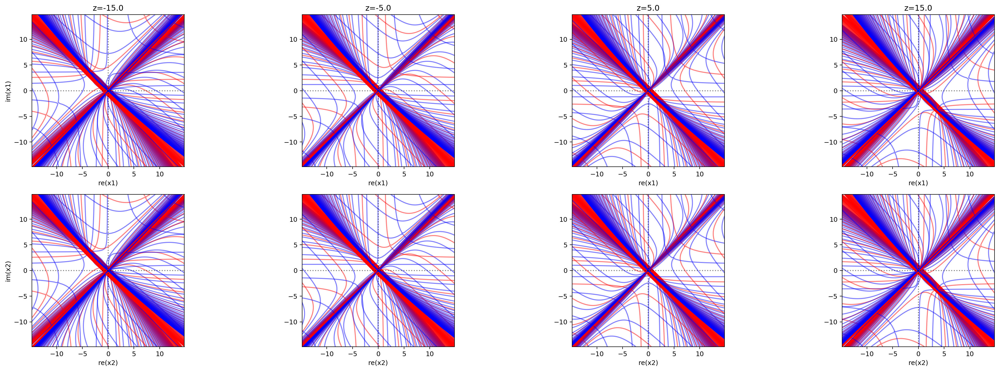

In [1681]:
plot_specsol(sbm_dummy)

In [1602]:
def test_3sbm(num=4, omega=5):
    for h in np.linspace(0, 1, num):
        sbm = {'pi':np.array([0.1, 0.3, 0.6]), 'psi':np.array([[1-h, h, 0], [h/2, 1-h, h/2], [0, h, 1-h]]), 'undirected':True}
        sbm['psi'] /= np.dot(sbm['psi'], sbm['pi'])[:,np.newaxis]/omega
        sbm['psi'] = (sbm['psi']+sbm['psi'].T)/2
        print(sbm['psi'])
        sol = solve_spectrum(sbm)
        adj = sample_sbm(sbm, plot=True, n=1000, num=250)
        eig_adj(adj, sbm, density=(sol[0], sol[1]), radius=sol[2])

[[50.          0.          0.        ]
 [ 0.         16.66666667  0.        ]
 [ 0.          0.          8.33333333]]


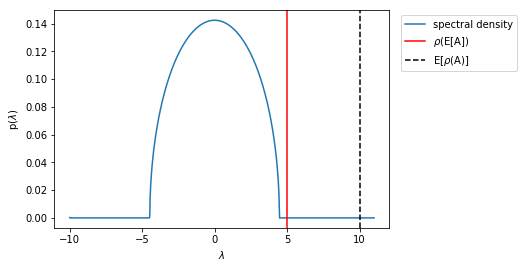

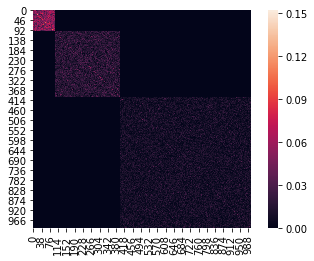

eig pi*psi: [5. 5. 5.]
eig E[adj]: [5. 5. 5.]
eig sample: [5.02037559 5.02587565 5.03981237]


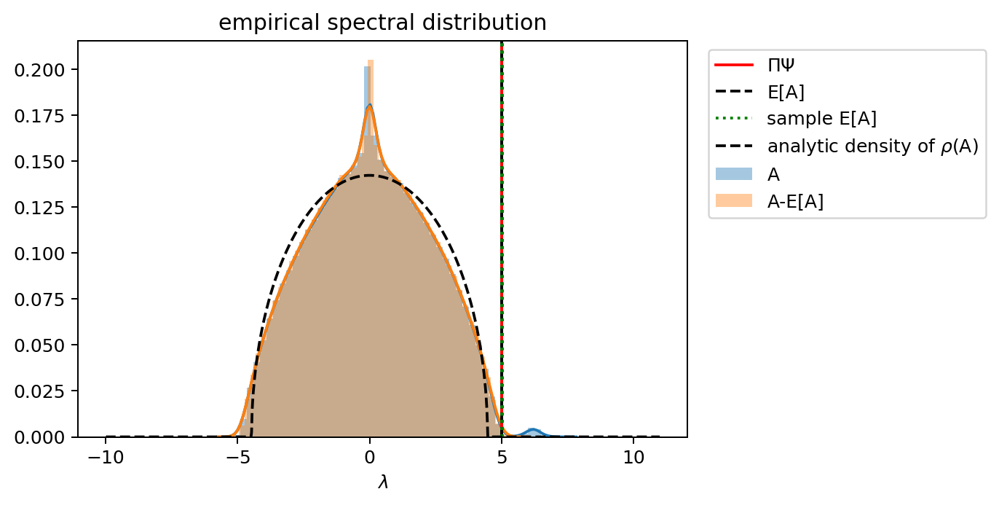

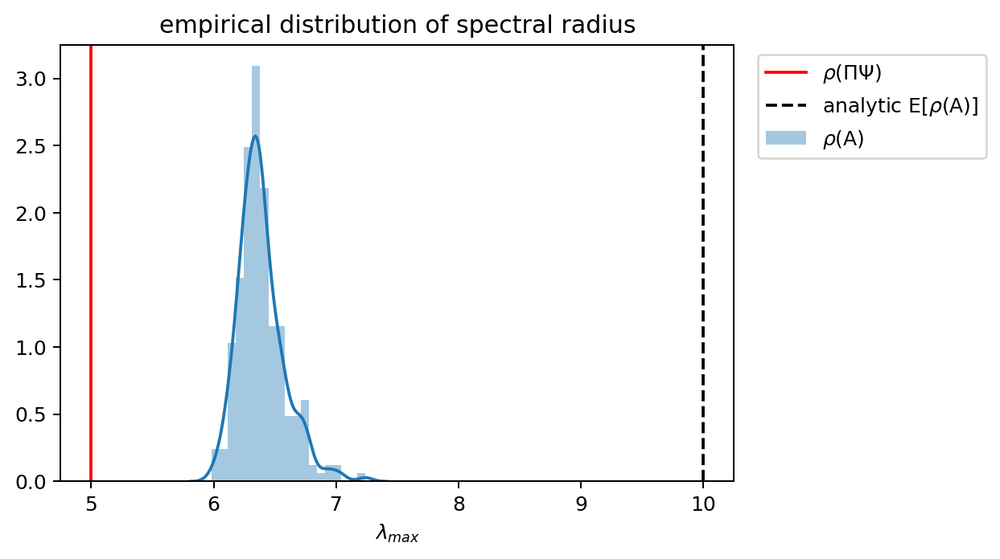

[[20.          6.31578947  0.        ]
 [ 6.31578947 10.52631579  2.98245614]
 [ 0.          2.98245614  6.66666667]]


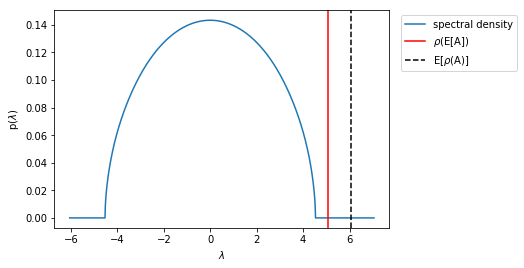

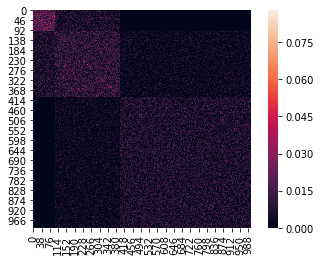

eig pi*psi: [1.16327783 2.93483446 5.05978245]
eig E[adj]: [1.16327783 2.93483446 5.05978245]
eig sample: [1.19818156 2.9580653  5.07224944]


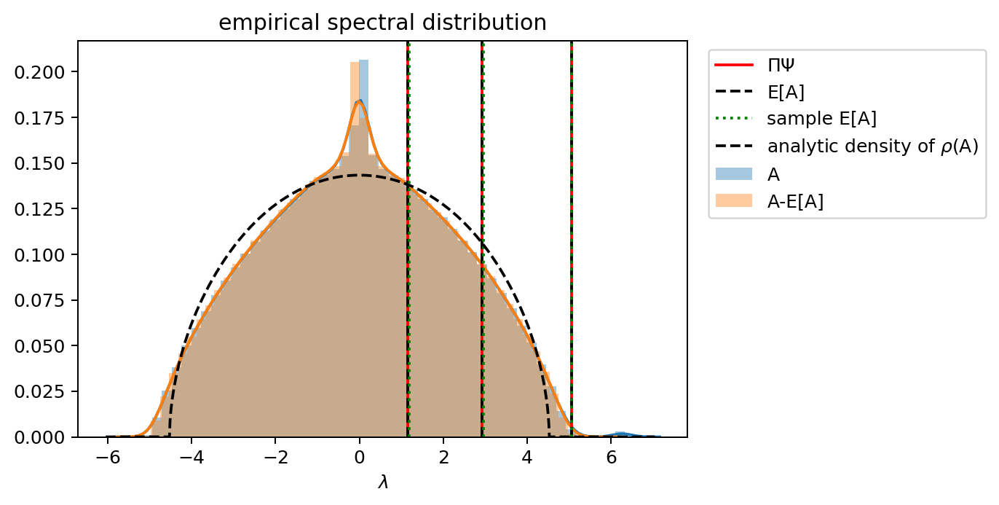

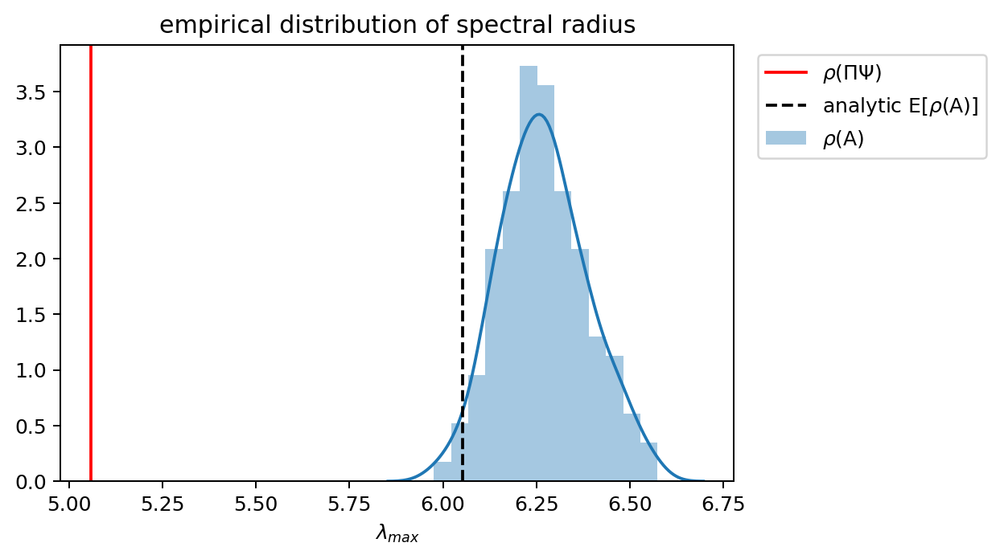

[[7.14285714 9.64285714 0.        ]
 [9.64285714 5.         6.66666667]
 [0.         6.66666667 4.16666667]]


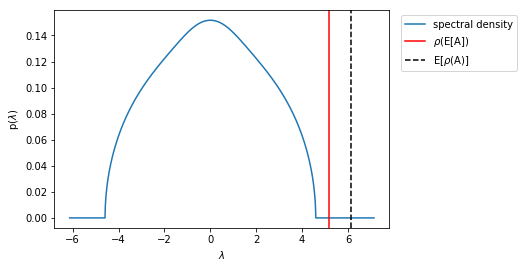

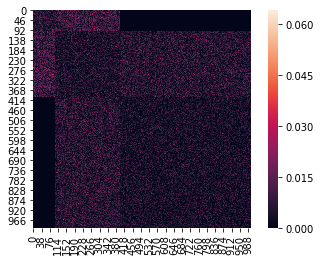

eig pi*psi: [ 1.19374354 -1.62847156  5.14901374]
eig E[adj]: [ 1.19374354 -1.62847156  5.14901374]
eig sample: [ 1.20859096 -1.6487461   5.15231716]


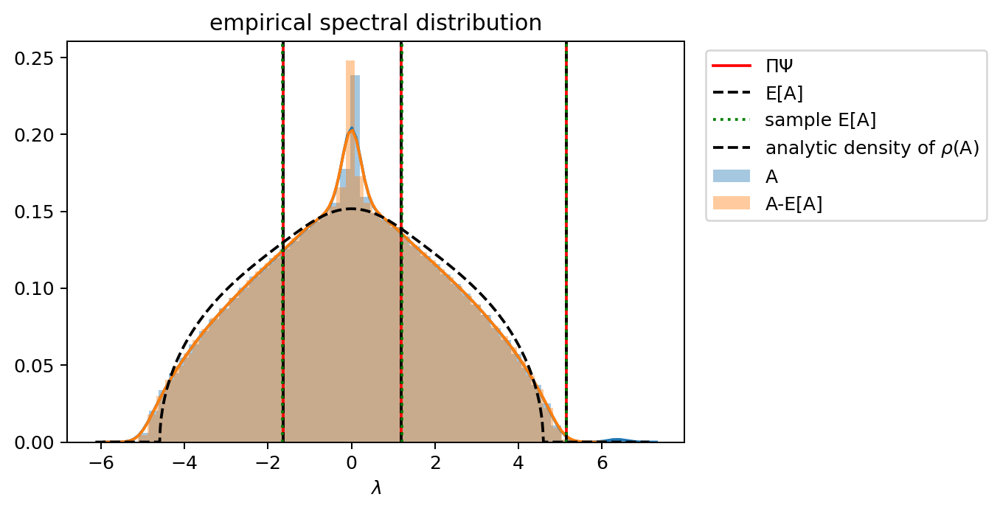

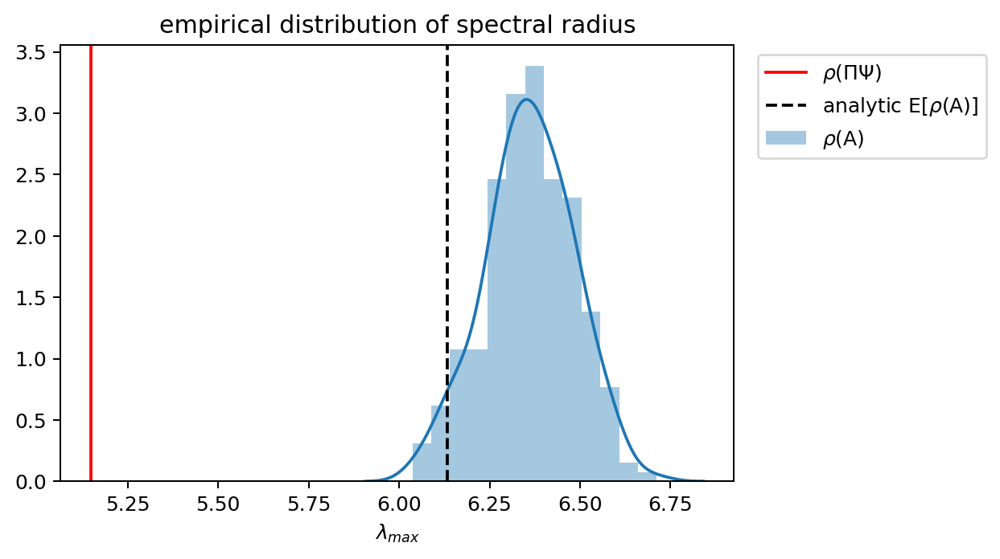

[[ 0.        11.9047619  0.       ]
 [11.9047619  0.        11.9047619]
 [ 0.        11.9047619  0.       ]]


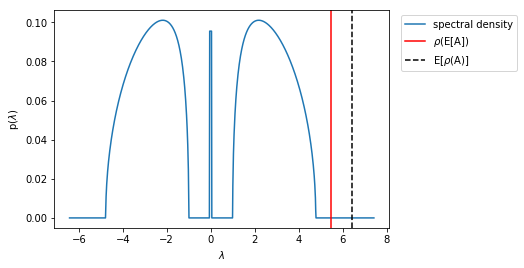

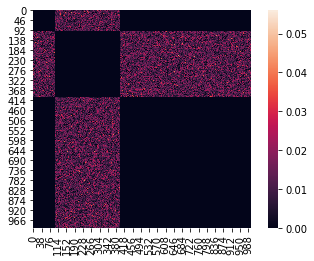

eig pi*psi: [ 6.93889390e-16 -5.45544726e+00  5.45544726e+00]
eig E[adj]: [ 3.58764662e-14 -5.45544726e+00  5.45544726e+00]
eig sample: [-0.301003    5.44128525 -5.44128525]


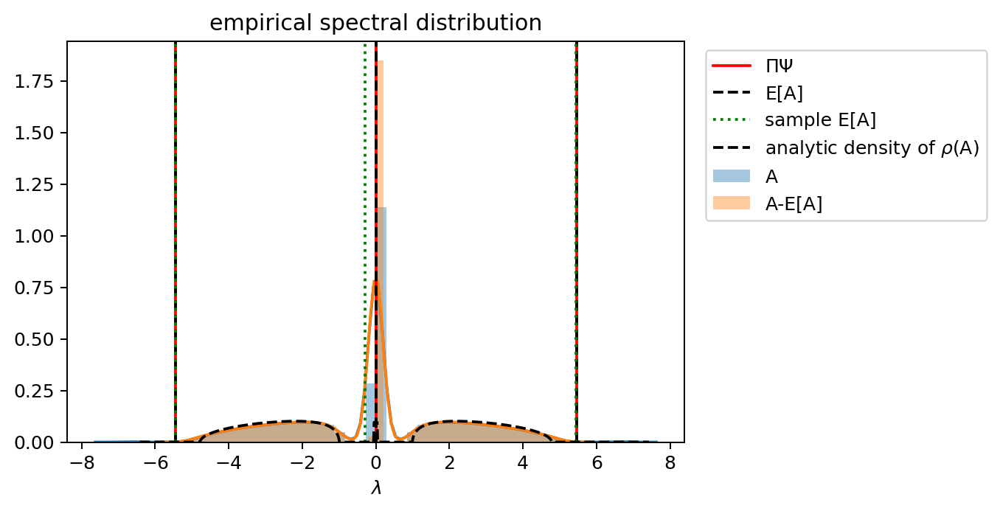

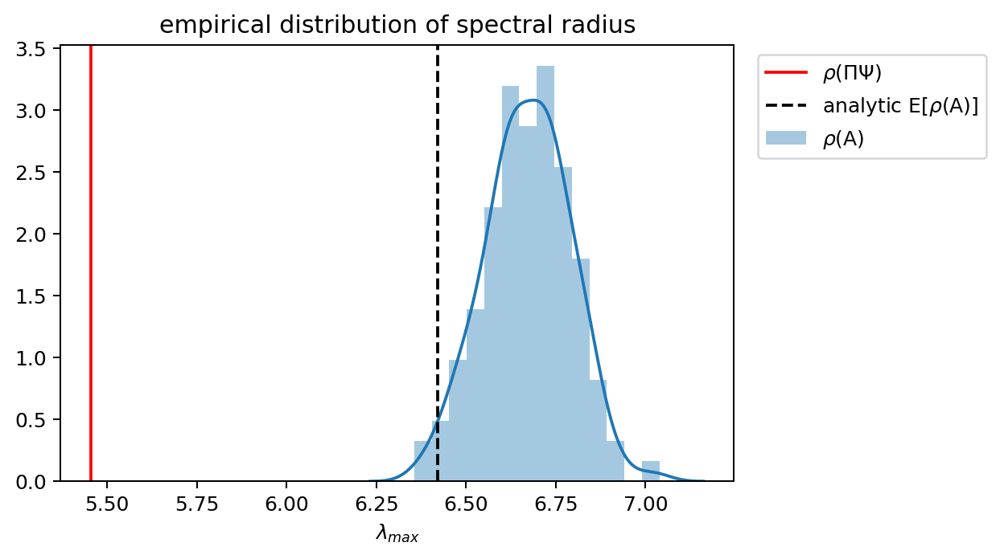

In [1603]:
test_3sbm()

In [36]:
alpha = 0
beta = 10
sbm_dummy = {'pi':np.array([0.8, 0.2]), 'psi':np.diag([alpha-beta, alpha-beta])+beta*np.ones((2,2)), 'undirected':True}
print(sbm_dummy['psi'])

[[ 0. 10.]
 [10.  0.]]


C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:162: RuntimeWarning: xtol=0.000000 is too small, no further improvement in the approximate
  solution is possible.
  warnings.warn(msg, RuntimeWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:162: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


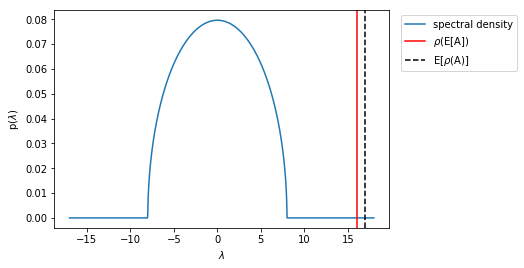

In [14]:
sbm = {'pi': np.array([0.5, 0.5]), 'psi': np.array([[ 16., 16.], [16.,  16.]]), 'undirected': True, 'p_reciprocate':1}
sbm_sol = solve_spectrum(sbm)

eig pi*psi: [-8.8817842e-16  8.0000000e+00]
eig E[adj]: [-1.36983605e-17  8.00000000e+00]
eig sample: [0.17991967 8.00294703]


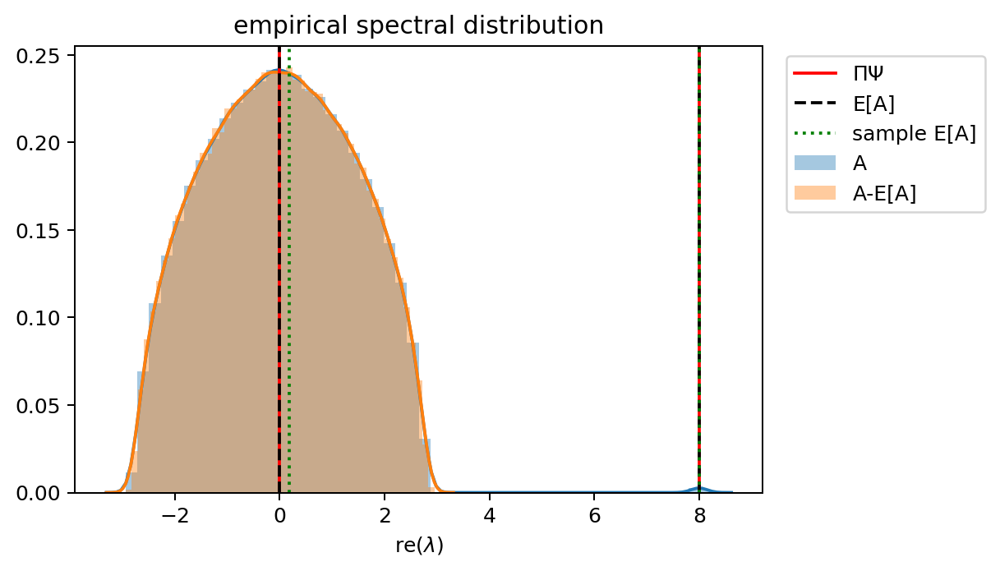

eig pi*psi: [0. 0.]
eig E[adj]: [-7.99318974e-16  7.99318974e-16]
eig sample: [-0.17721821  0.17721821]


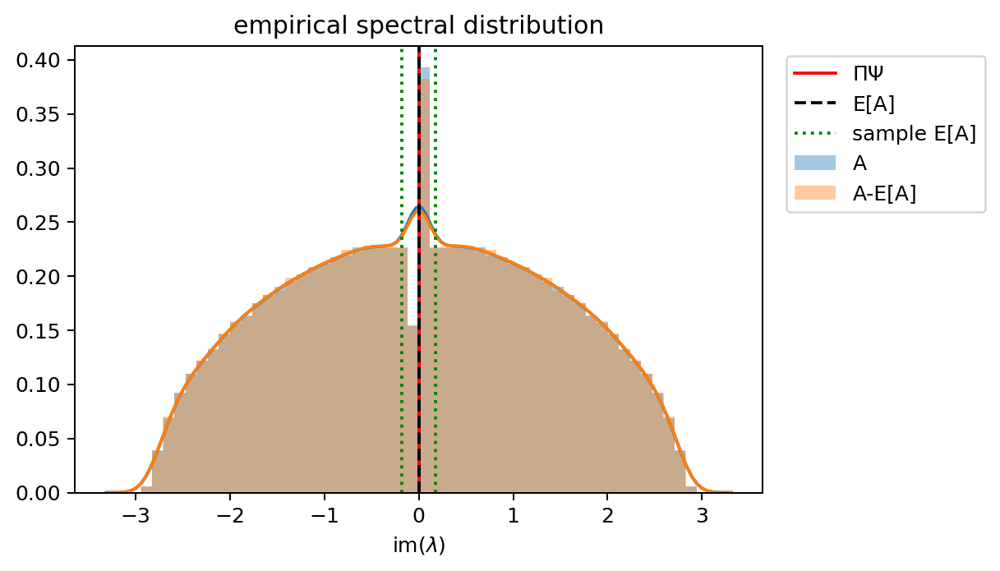

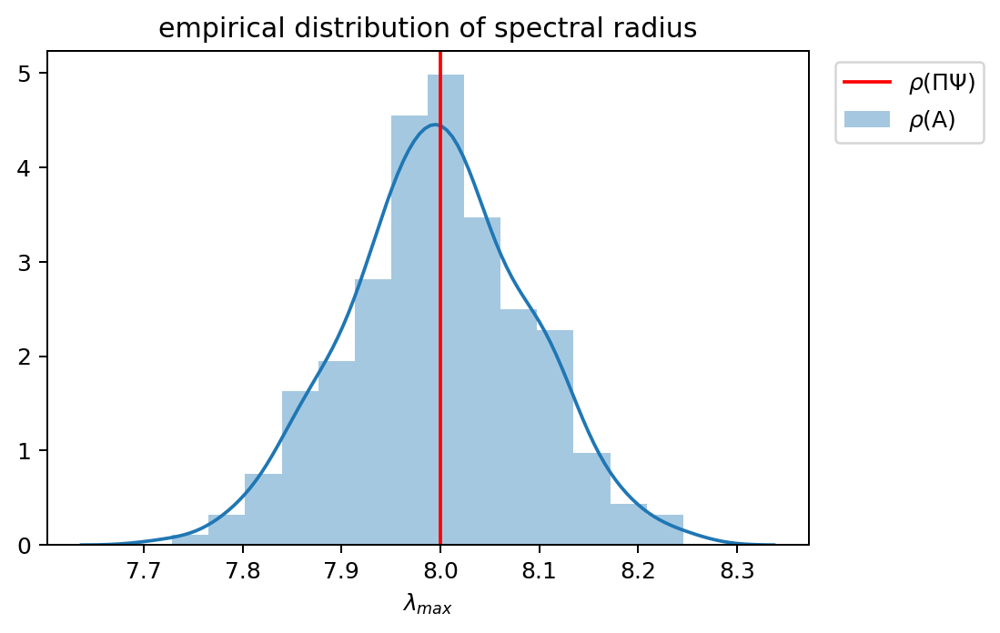

In [13]:
sbm_adj = sample_sbm(sbm, p_reciprocate=0)
eig_adj(sbm_adj, sbm)

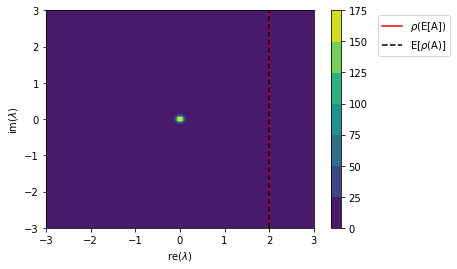

In [27]:
sbm_dum_sol = solve_spectrum_reci(sbm_dummy)

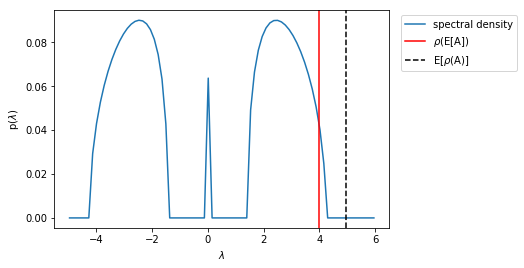

In [37]:
sbm_dum_sol_reci = solve_spectrum(sbm_dummy, p_reciprocate=1, nbins=80)

[ 0. 32.]


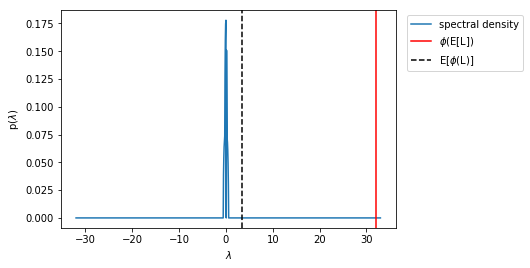

In [1715]:
sbm_dum_lap_sol = solve_spectrum_laplacian(sbm_dummy)

[4.60612599e-16 9.54138720e+00 9.91902882e+00 1.06394563e+01]


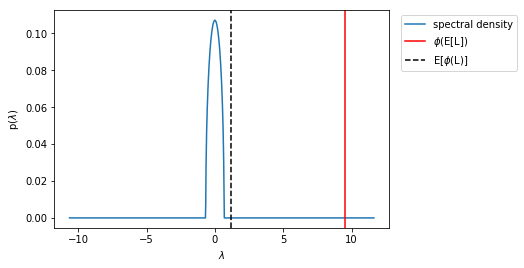

In [1716]:
sbm_het_lap_sol = solve_spectrum_laplacian(sbm_het)

[5.17086509e-16 6.09906747e+00 7.07955928e+00 7.26705339e+00]


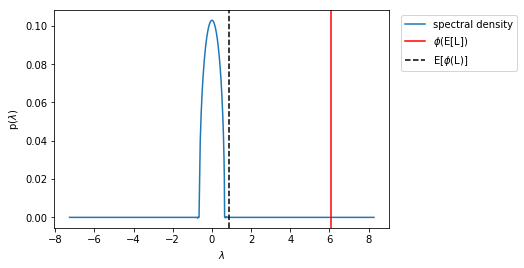

In [1717]:
sbm_hom_lap_sol = solve_spectrum_laplacian(sbm_hom)

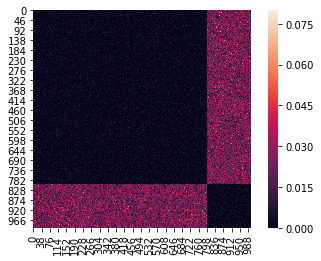

eig pi*psi: [-8.86054109 10.36054109]
eig E[adj]: [-8.86054109 10.36054109]
eig sample: [-8.87081677 10.3721718 ]


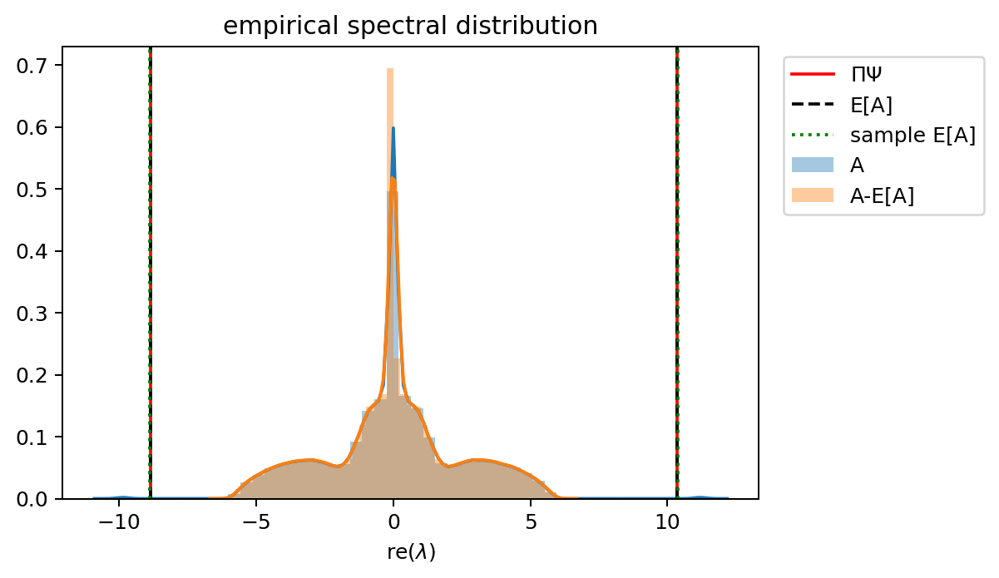

eig pi*psi: [0. 0.]
eig E[adj]: [ 8.08594836e-29 -8.08594836e-29]
eig sample: [-0.05138175  0.05138175]


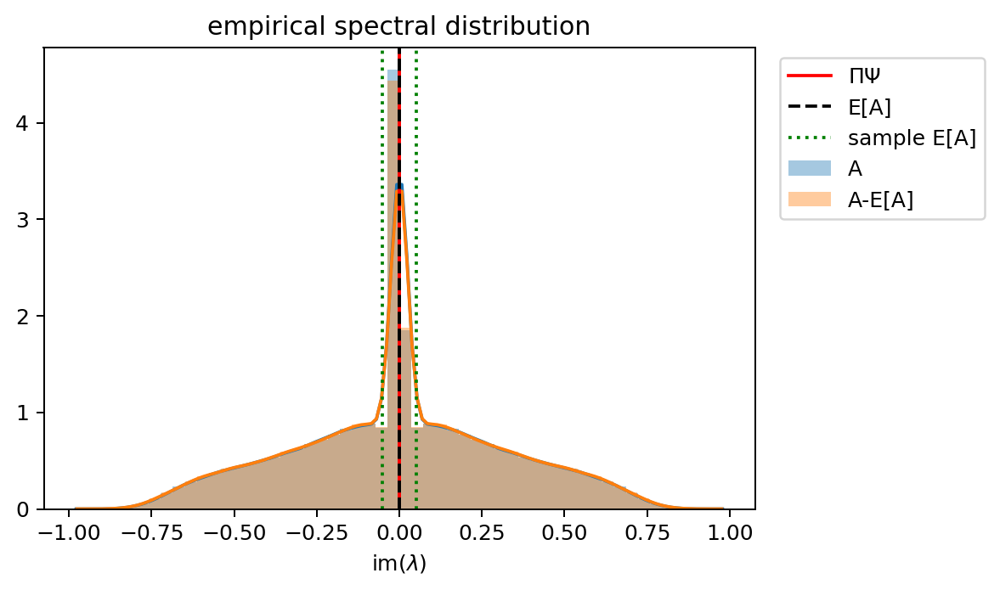

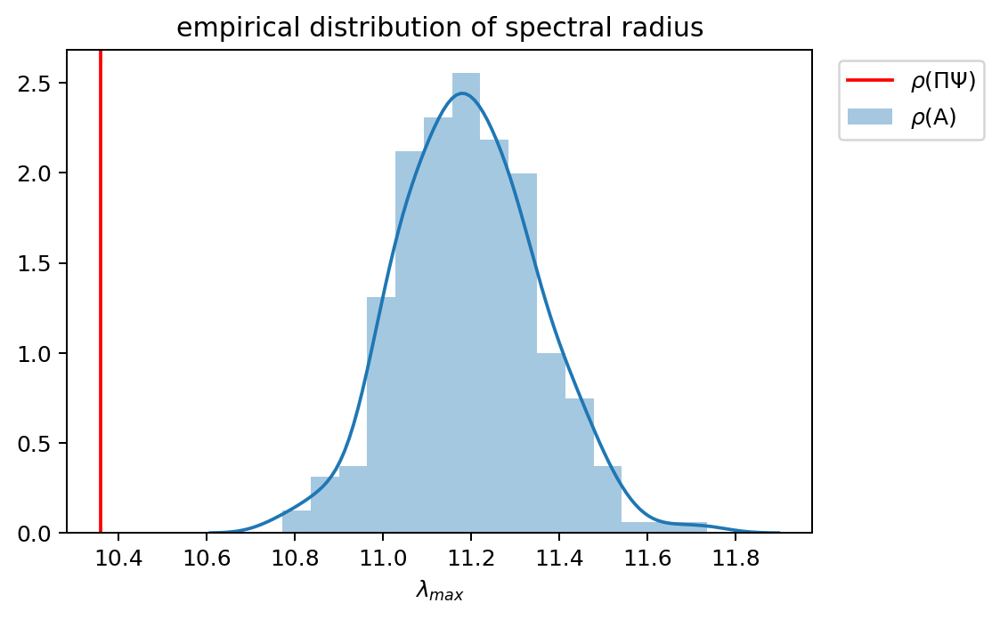

In [1954]:
adj_dummy = sample_sbm(sbm_dummy, p_reciprocate=0.5, plot=True)
eig_adj(adj_dummy, sbm_dummy)

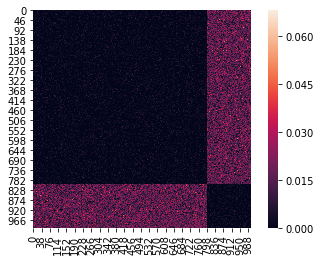

eig pi*psi: [-5.90702739  6.90702739]
eig E[adj]: [-5.90702739  6.90702739]
eig sample: [-5.90983926  6.91461657]


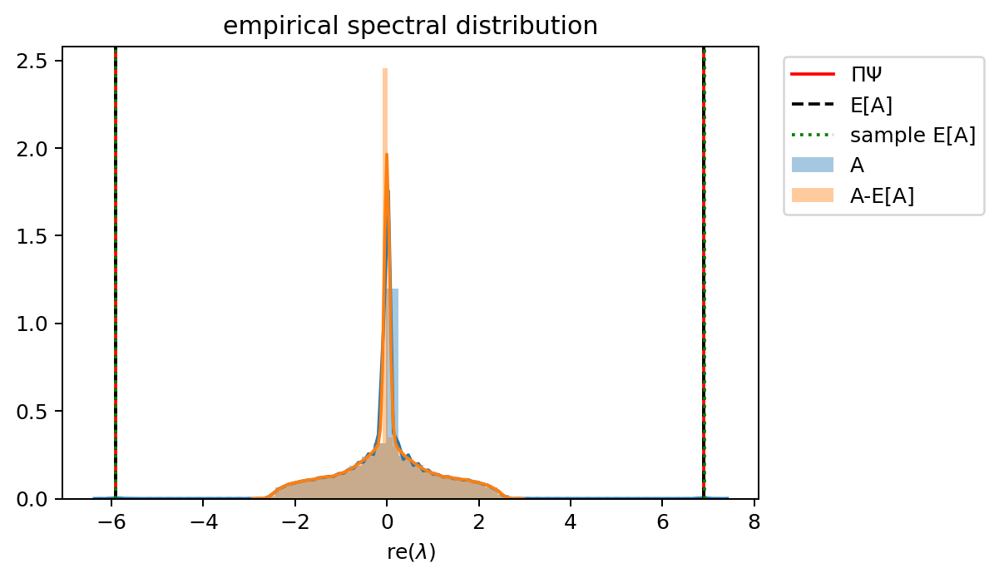

eig pi*psi: [0. 0.]
eig E[adj]: [-6.14768988e-29  6.14768988e-29]
eig sample: [ 0.16663735 -0.16663735]


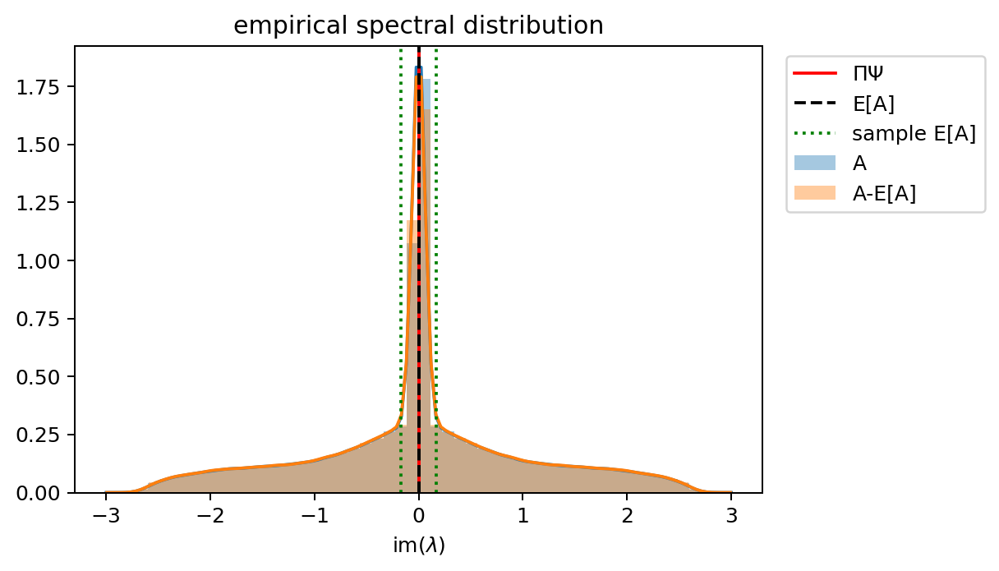

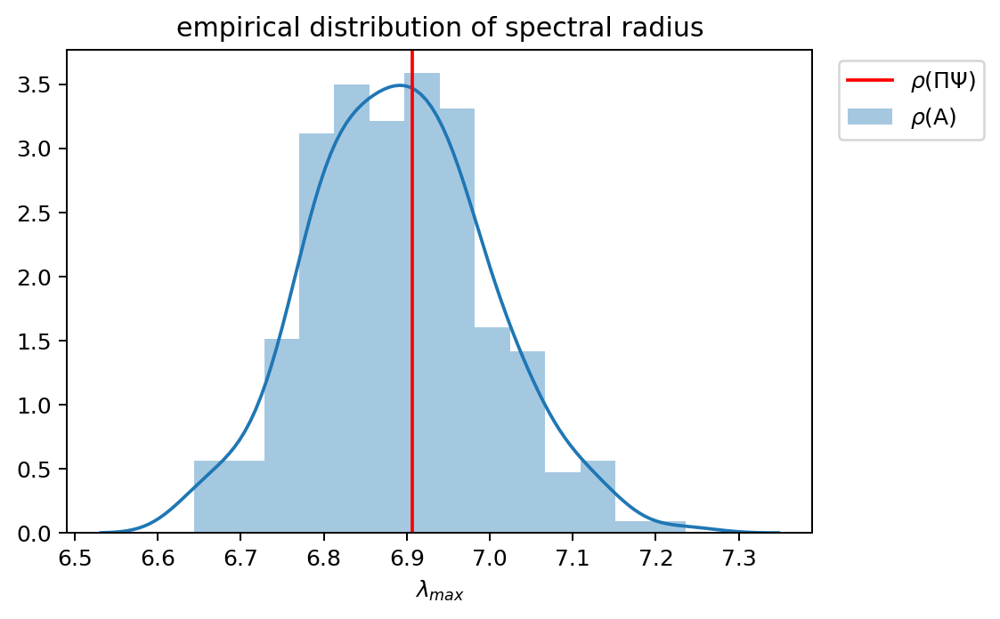

In [1955]:
adj_dummy = sample_sbm(sbm_dummy, p_reciprocate=0., plot=True)
eig_adj(adj_dummy, sbm_dummy)

using p_reciprocate [1. 1.]


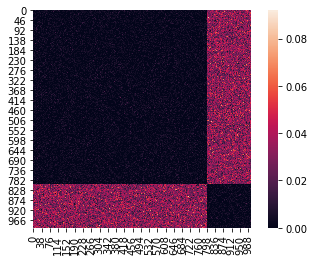

In [1893]:
adj_dummy = sample_sbm(sbm_dummy, p_reciprocate='auto', shuffle=False, plot=True)
#eig_adj(adj_dummy, sbm_dummy, density=sbm_dum_sol)

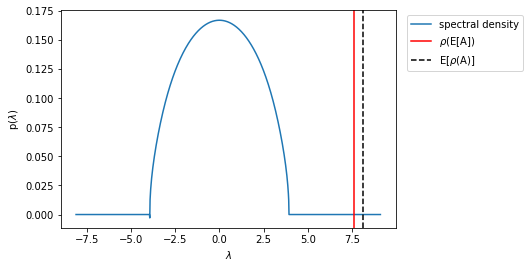

In [1947]:
sbm_hom_sol = solve_spectrum(sbm_hom, p_reciprocate=0.5)

number of people slightly reduced to 998


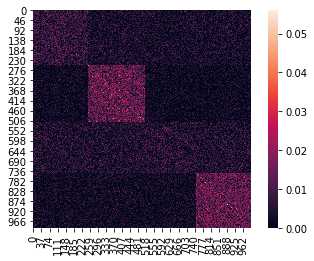

In [1950]:
adj_hom = sample_sbm(sbm_hom, p_reciprocate=0, plot=True)

eig pi*psi: [0.47961792 1.63349249 2.82702189 5.02025503]
eig E[adj]: [0.47909326 1.6296082  2.82050752 5.00955671]
eig sample: [0.48544201 1.63732072 2.83607349 5.0170936 ]


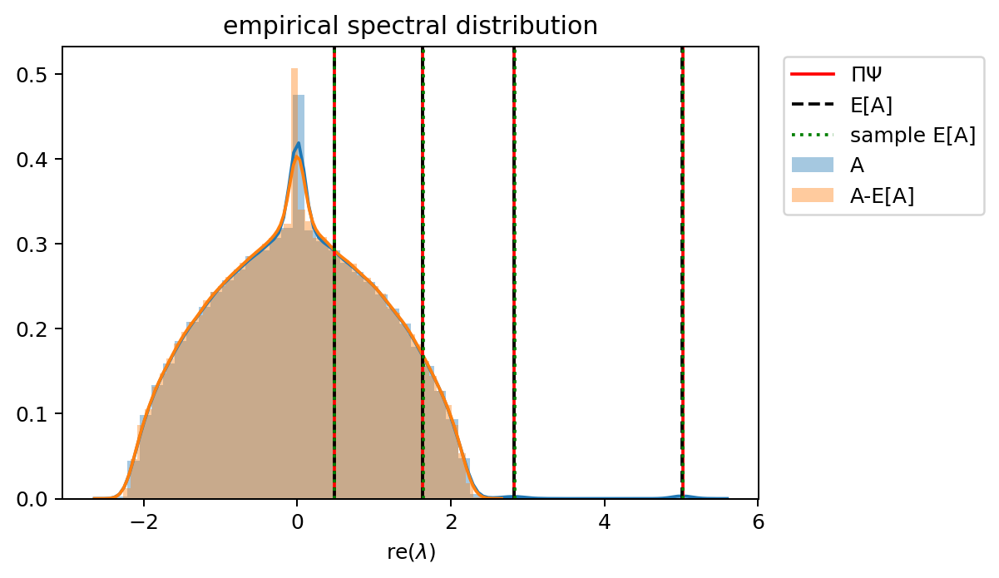

eig pi*psi: [0. 0. 0. 0.]
eig E[adj]: [ 2.14678637e-25 -2.14678637e-25 -5.10027828e-25  5.10027828e-25]
eig sample: [ 0.14003206 -0.14003206  0.14112637 -0.14112637]


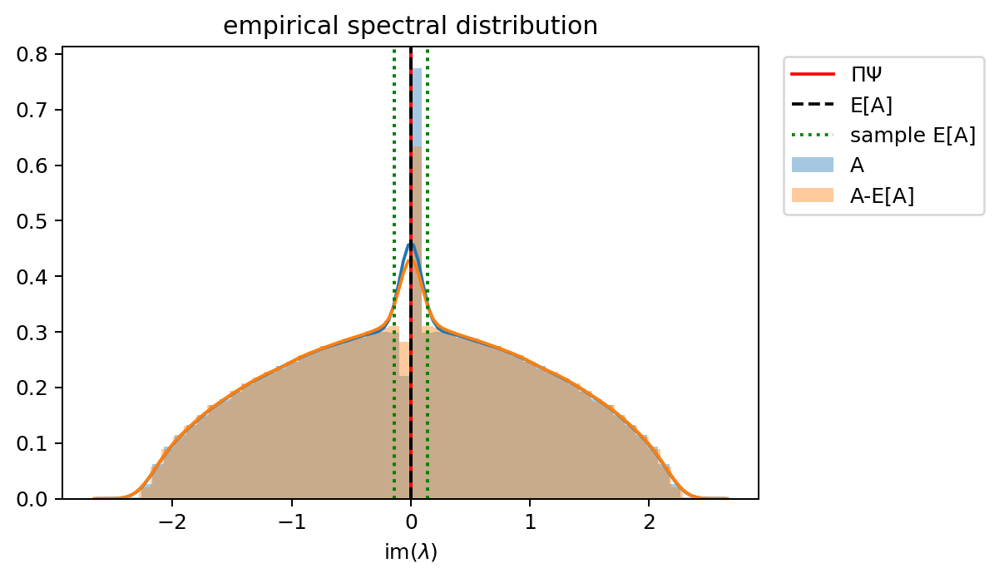

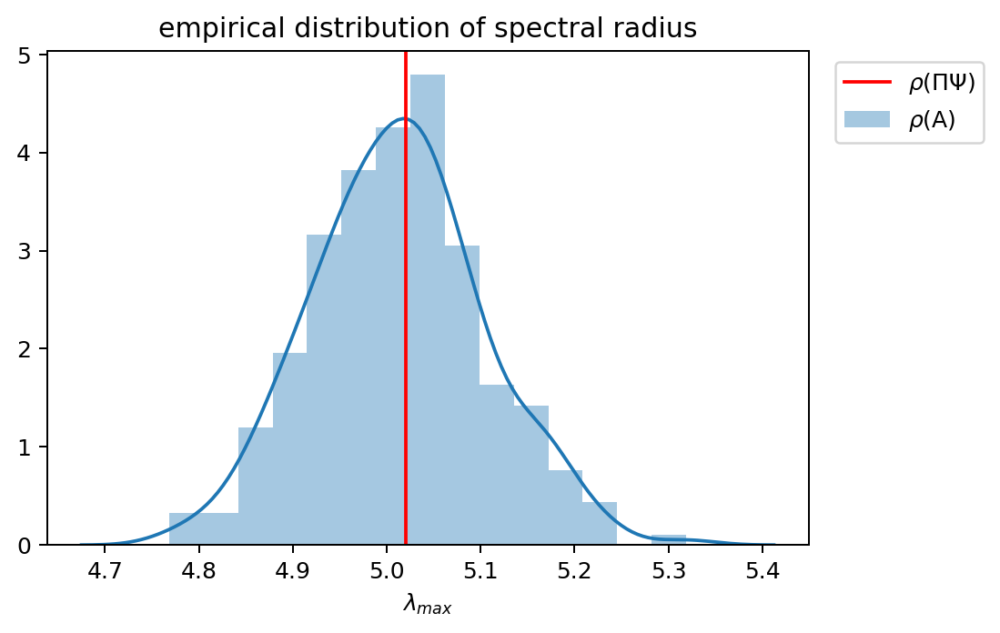

In [1951]:
eig_adj(adj_hom, sbm_hom)#, density=sbm_hom_sol)

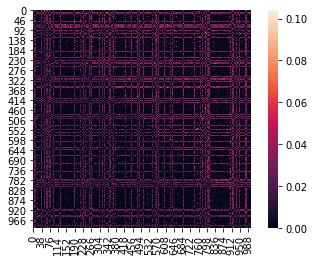

eig pi*psi: [-10.33729794  12.08729794]
eig E[adj]: [-10.52102701  12.27102701]
eig sample: [-10.44452754  12.17529828]


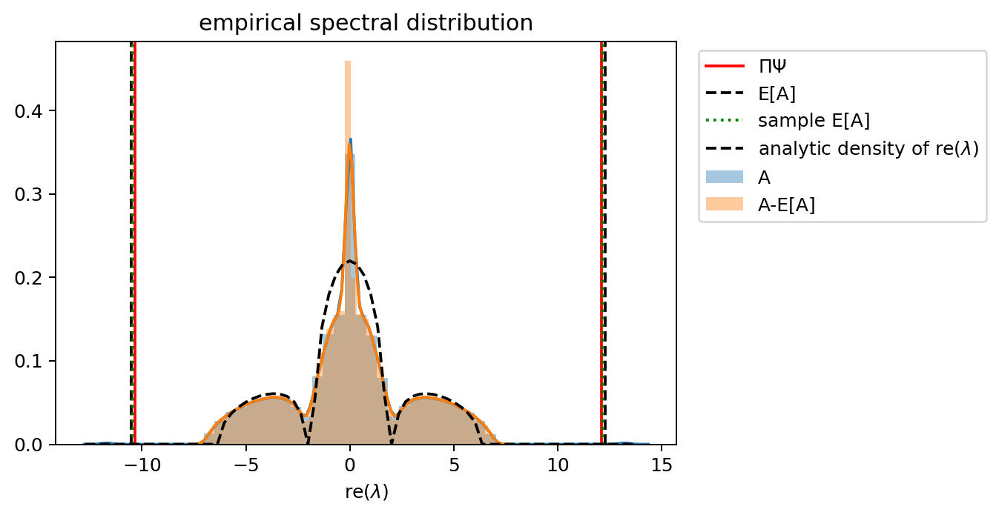

eig pi*psi: [0. 0.]
eig E[adj]: [-1.12041365e-28  1.12041365e-28]
eig sample: [-0.47770186  0.47770186]


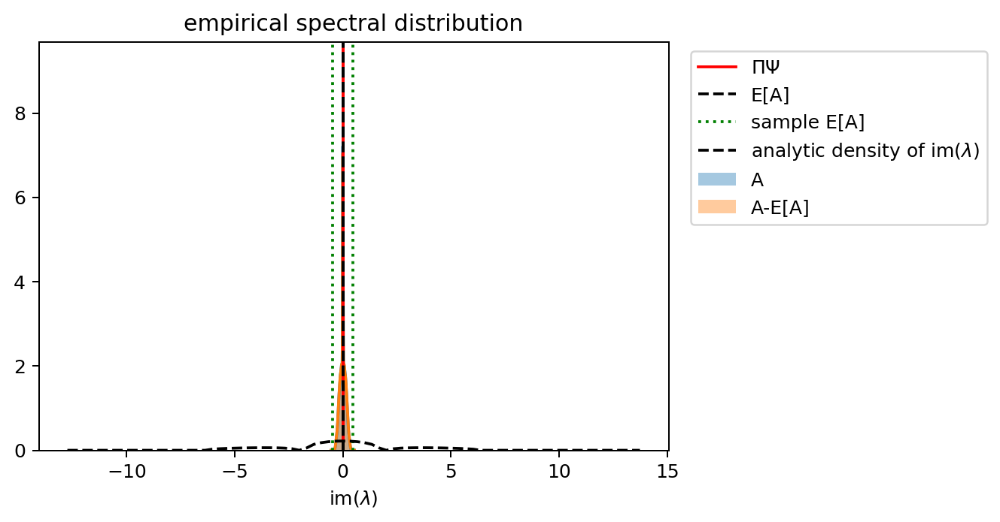

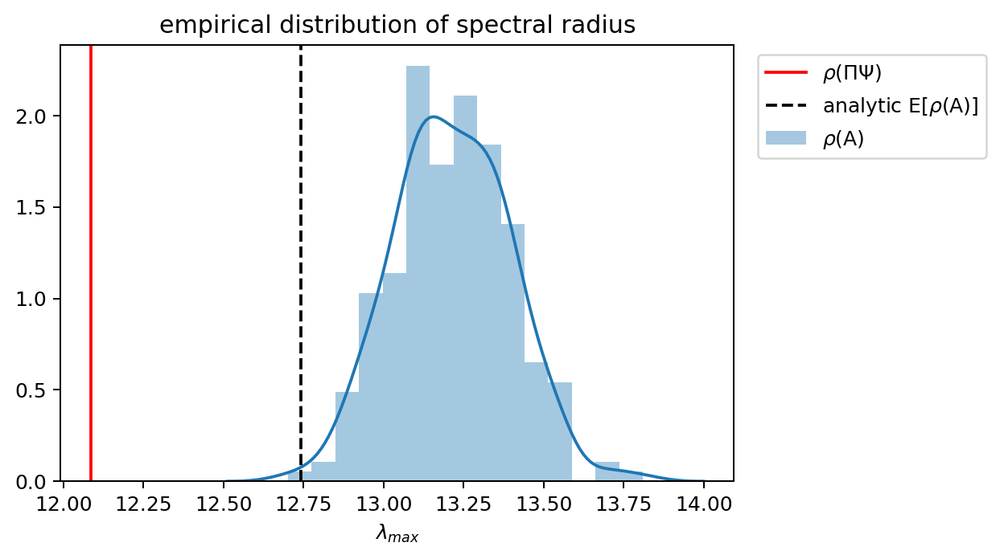

In [1844]:
adj_dummy = sample_sbm(sbm_dummy, p_reciprocate=0.75, plot=True)
eig_adj(adj_dummy, sbm_dummy, density=sbm_dum_sol_reci)

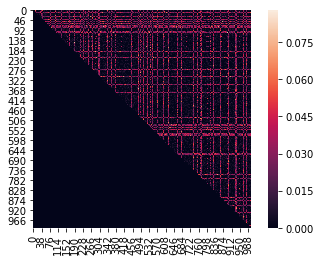

eig pi*psi: [-5.90702739  6.90702739]
eig E[adj]: [-6.04593614  7.04593614]
eig sample: [0.016 0.016]


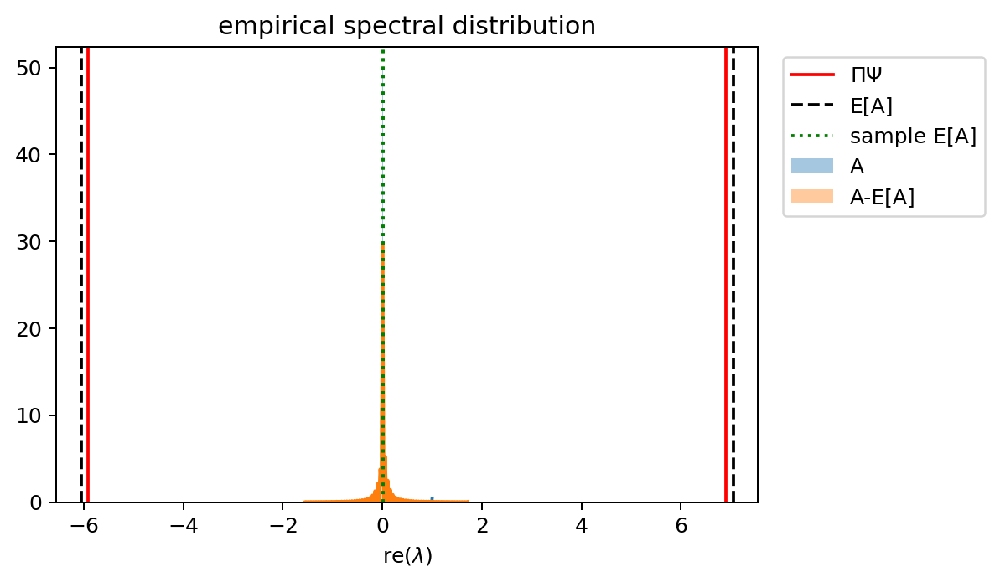

eig pi*psi: [0. 0.]
eig E[adj]: [-2.00282888e-16  2.00282888e-16]
eig sample: [0. 0.]


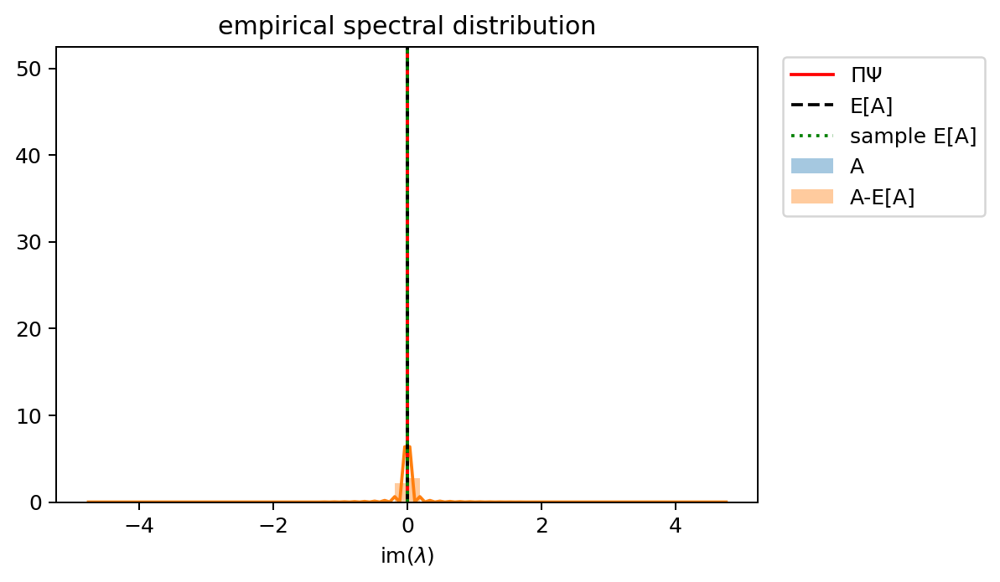

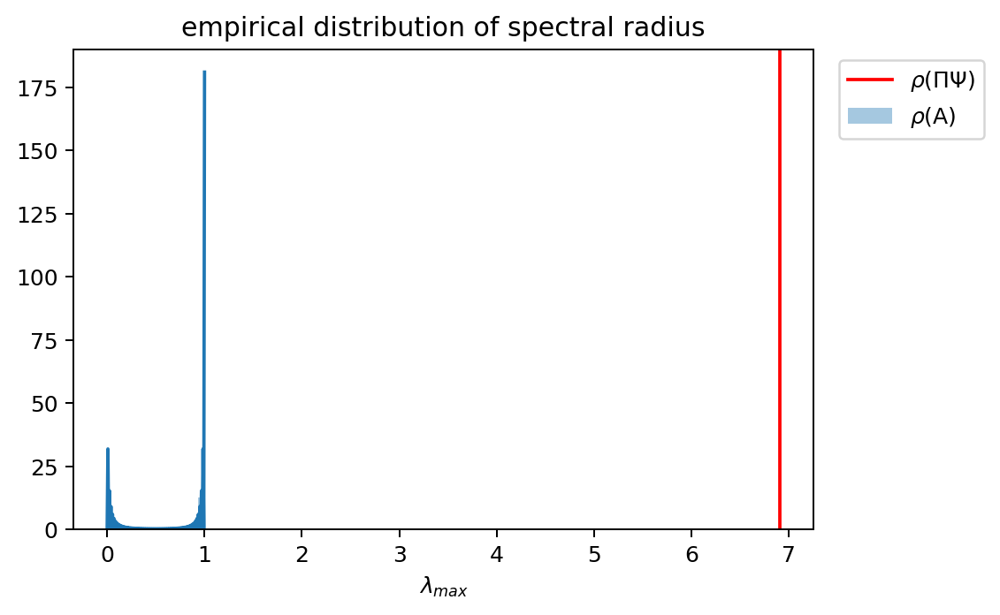

In [1847]:
adj_dummy = sample_sbm(sbm_dummy, p_reciprocate=0.0, plot=True)
eig_adj(adj_dummy, sbm_dummy)

eig pi*lap: [ 0. 32.]
eig E[lap]: [1.35755362e-14 8.00000000e+00]
eig sample: [5.32907052e-15 7.38571599e+00]


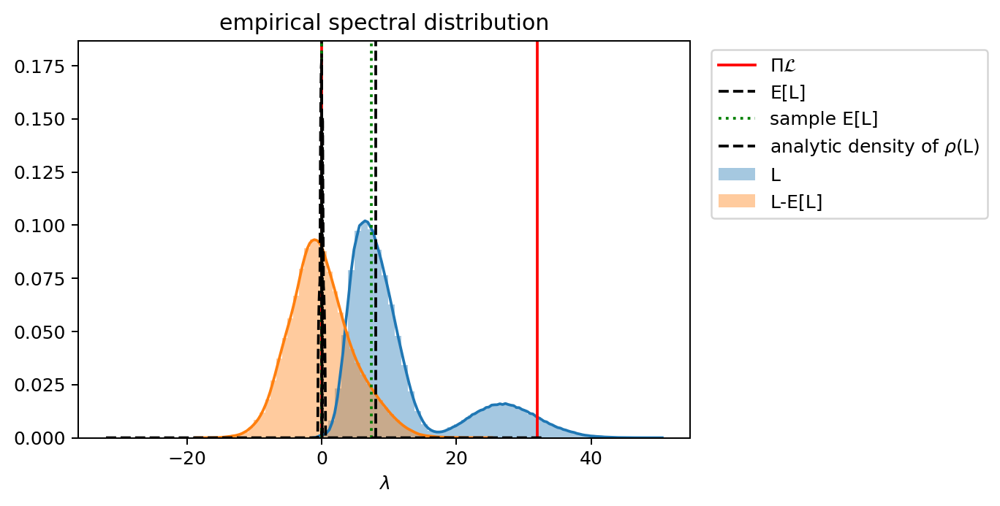

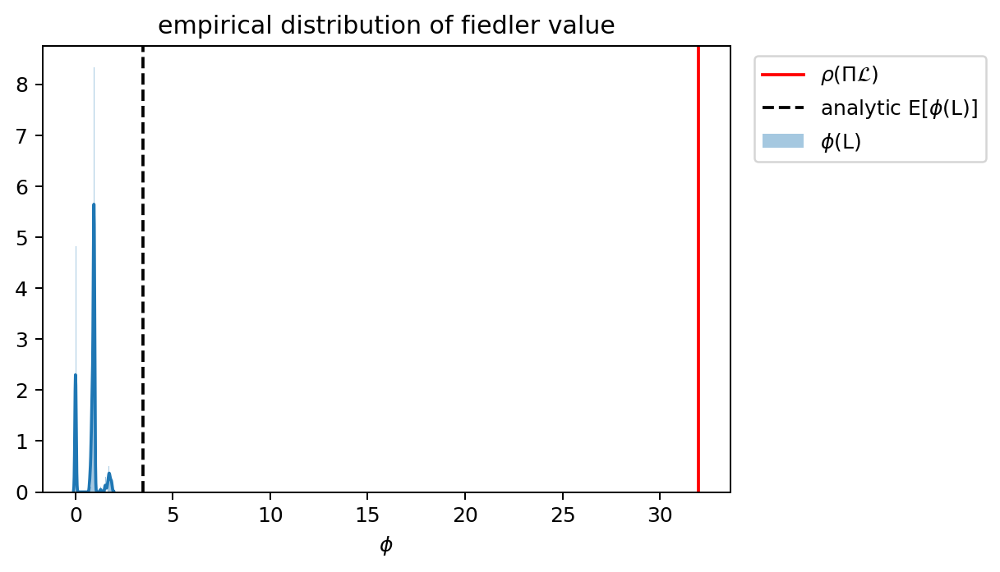

In [1721]:
eig_lap(adj_dummy, sbm_dummy, density=(sbm_dum_lap_sol[0], sbm_dum_lap_sol[1]), radius=sbm_dum_lap_sol[2])

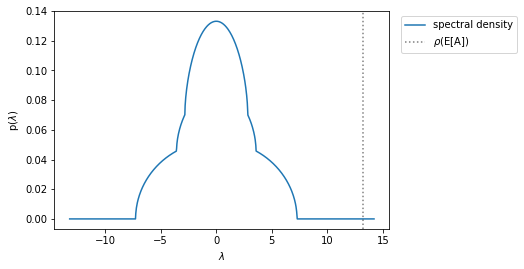

In [1269]:
sbm_dum_sol = solve_spectrum(sbm_dummy)

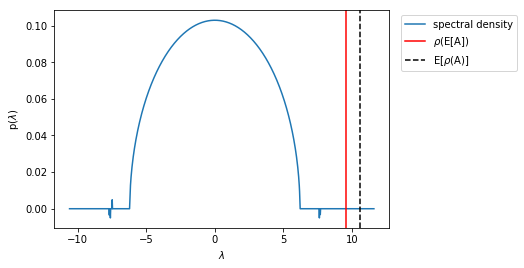

In [1537]:
sbm_hom_sol = solve_spectrum(sbm_hom)

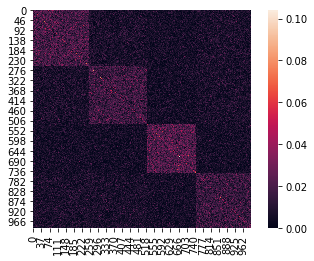

eig pi*psi: [2.13695424 2.68179996 3.43598728 9.59548869]
eig E[adj]: [2.13445857 2.6765613  3.42570515 9.57660121]
eig sample: [2.17559078 2.71605535 3.44725984 9.60962806]


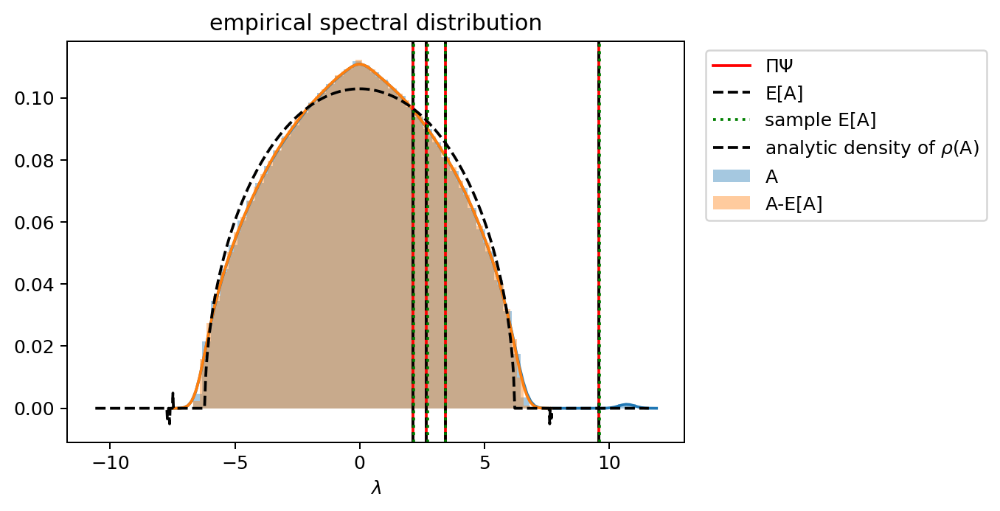

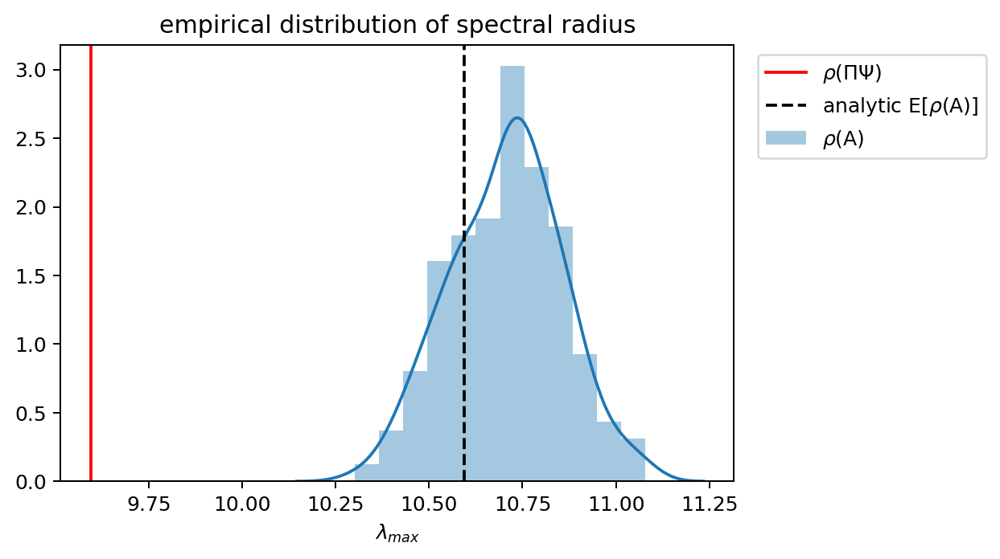

In [1538]:
adj_hom = sample_sbm(sbm_hom, plot=True)
eig_adj(adj_hom, sbm_hom, density=(sbm_hom_sol[0], sbm_hom_sol[1]), radius=sbm_hom_sol[2])

eig pi*lap: [5.17086509e-16 6.09906747e+00 7.07955928e+00 7.26705339e+00]
eig E[lap]: [3.44192531e-15 6.08703111e+00 7.06580741e+00 7.25308857e+00]
eig sample: [1.77635684e-15 6.08305504e+00 7.04988820e+00 7.23857590e+00]


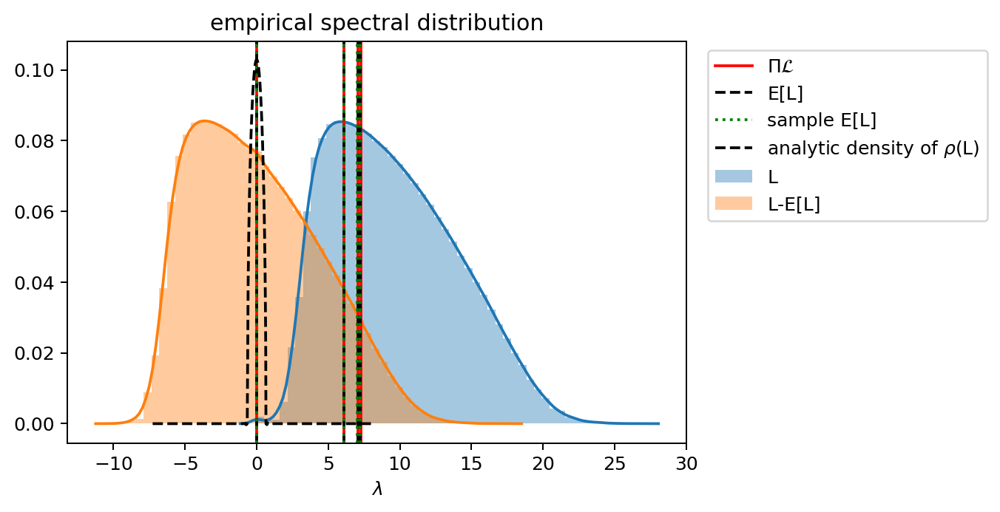

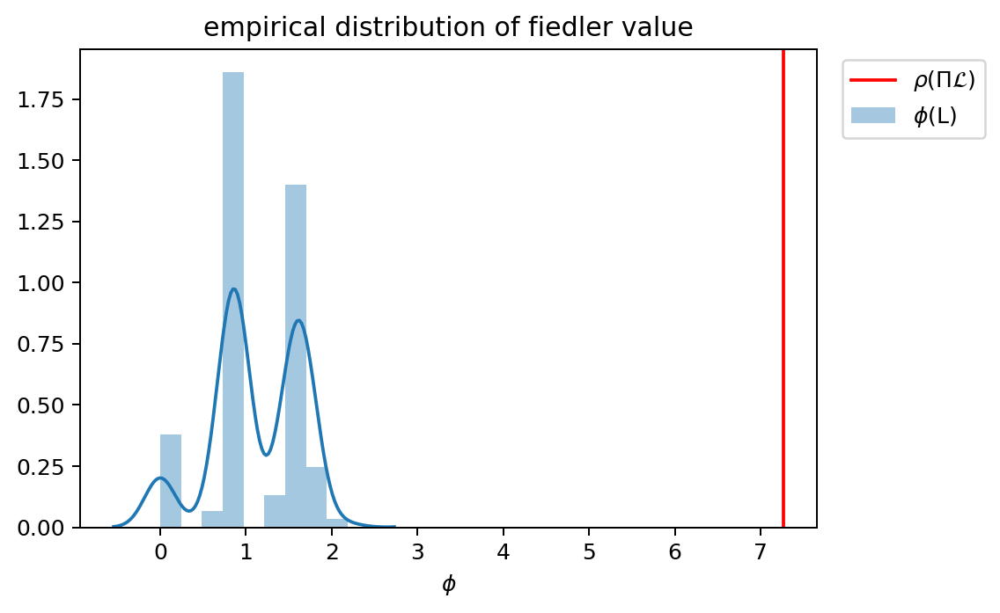

In [1722]:
eig_lap(adj_hom, sbm_hom, density=(sbm_hom_lap_sol[0], sbm_hom_lap_sol[1]))

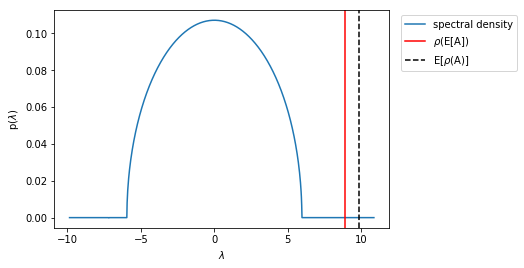

In [1539]:
sbm_het_sol = solve_spectrum(sbm_het)

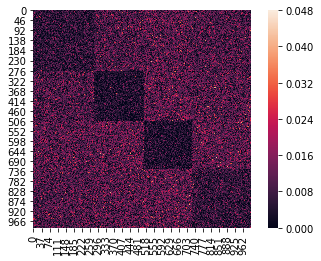

eig pi*psi: [-0.85658119 -1.11194513 -1.54476304  8.85446554]
eig E[adj]: [-0.85391203 -1.10895571 -1.53986091  8.82795333]
eig sample: [-0.88946091 -1.14617127 -1.56590877  8.84369742]


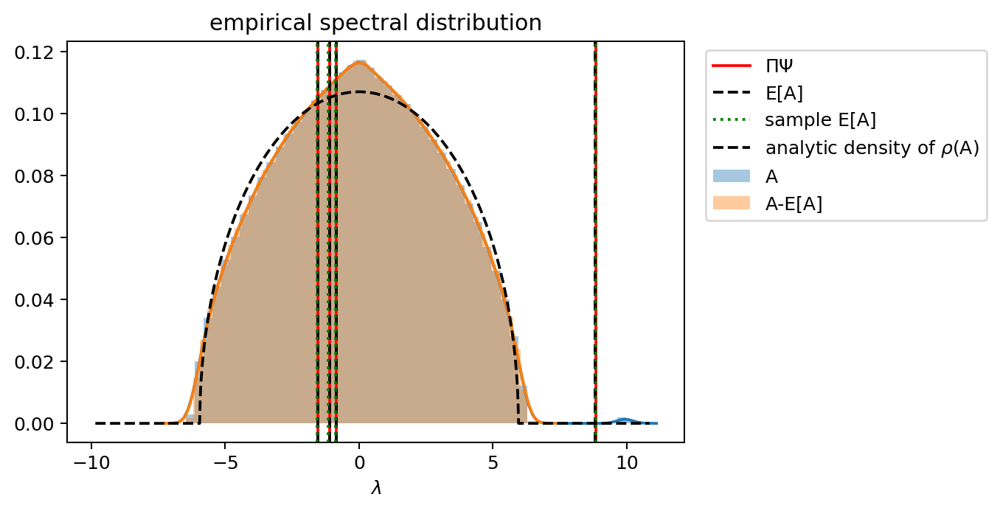

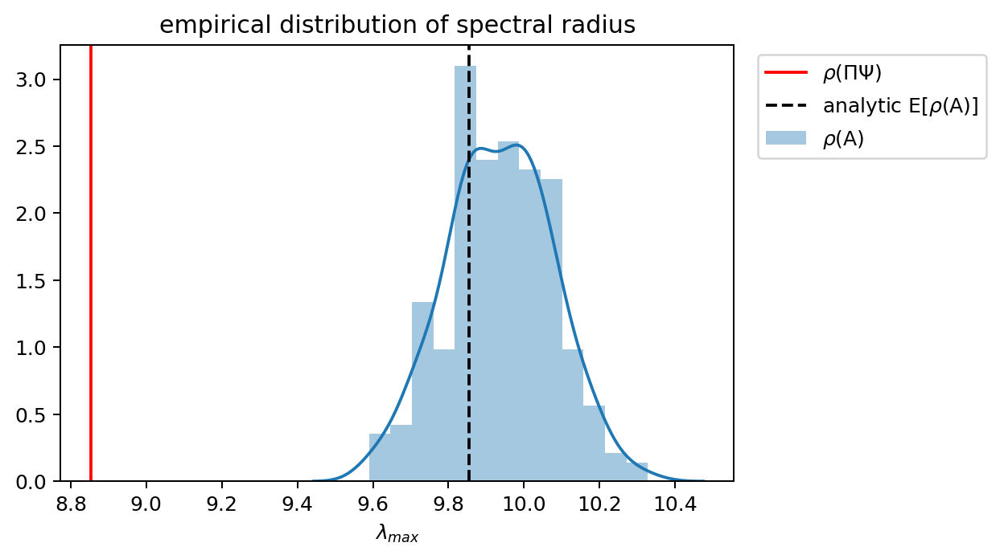

In [1540]:
adj_het = sample_sbm(sbm_het, plot=True)
eig_adj(adj_het, sbm_het, density=(sbm_het_sol[0], sbm_het_sol[1]), radius=sbm_het_sol[2])

eig pi*lap: [4.60612599e-16 9.54138720e+00 9.91902882e+00 1.06394563e+01]
eig E[lap]: [1.77635684e-15 8.54023831e+00 8.54023831e+00 8.54023831e+00]
eig sample: [-2.84217094e-14  7.99944880e+00  8.03938705e+00  8.05044654e+00]


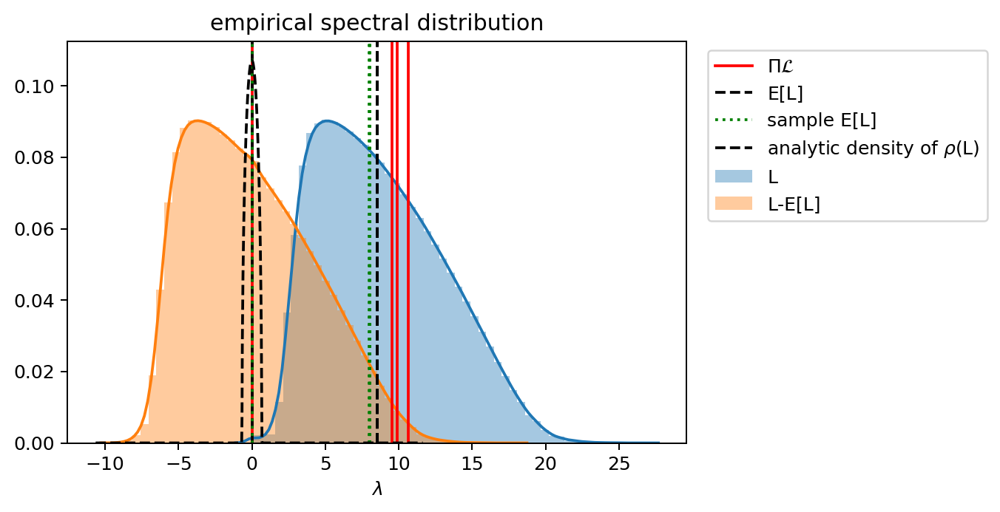

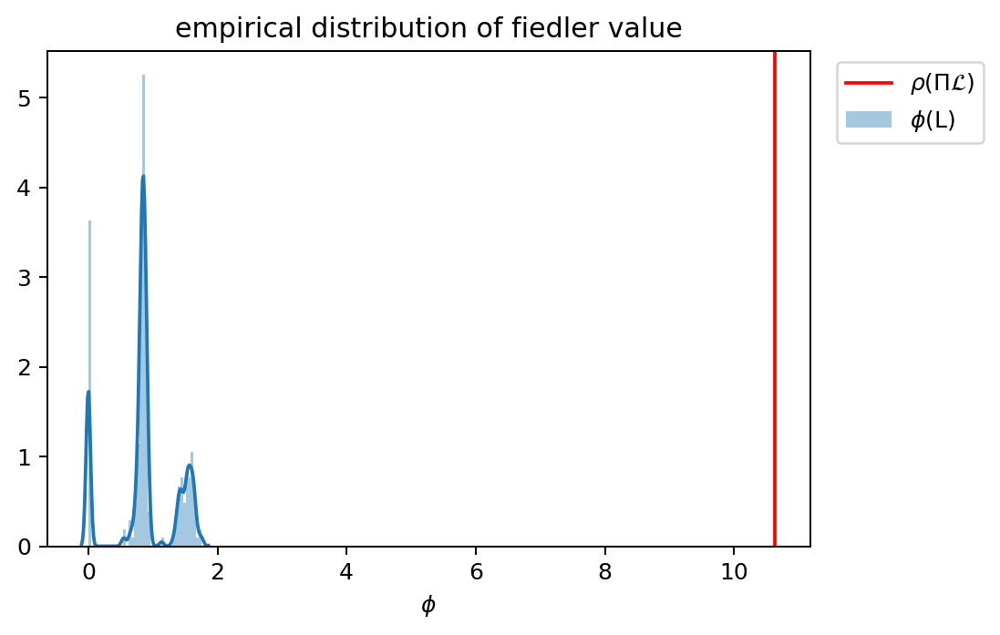

In [1723]:
eig_lap(adj_het, sbm_het, density=(sbm_het_lap_sol[0], sbm_het_lap_sol[1]))

In [1743]:
beta=1
x = np.linalg.eigvalsh(np.diag([1,2,3])+beta*np.ones((3,3)))
print(x)

[1.32486913 2.46081113 5.21431974]


In [1798]:
def eig_simple_eda(d, beta=0., nbins=1000):
    import numpy as np
    import matplotlib.pyplot as plt
    d = np.sort(d)
    m = len(d)
    z = np.linspace(d[0]-1, d[-1]+1)
    y = [(1/(z_i-d)).sum() for z_i in z]
    plt.plot(z, y)
    plt.gca().axhline(0, ls=':', c='black')
    plt.gca().axvline(0, ls=':', c='black')
    if beta!=0: plt.gca().axhline(m**2/beta, ls='--', c='black')
    for i in d: plt.gca().axvline(i, ls='--', c='red')
    plt.gca().set_ylim(-m**2/beta, 2*m**2/beta)
    plt.show()
    print(d)
    alpha = (1/np.diff(d)).sum()
    print(alpha, m**2-alpha*beta)
    return d[-1] + beta/(m**2-alpha*beta)

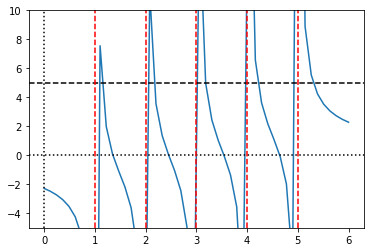

[1 2 3 4 5]
4.0 5.0


6.0

In [1805]:
eig_simple_eda([1,2,3,4,5], 5)

In [2044]:
def solve_specrad_diag(omega, pi):
    import sympy as sym
    import matplotlib.pyplot as plt
    from scipy.optimize import fsolve
    def g():
        z = sym.symbols('z')
        expn = (z - (z**2-4*omega[0]*pi[0])**0.5)/(2*omega[0])
        for i in range(1, len(omega)): expn += (z - (z**2-4*omega[i]*pi[i])**0.5)/(2*omega[i])
        return expn
    def foo(x, func, radius): return float(func.subs({'z':x}))-1/radius
    g_z = g()
    print(g_z)
    density = -(sym.im(g_z))/sym.pi
    radius = max([om*p for (om,p) in zip(omega, pi)])
    print(radius)
    radius = fsolve(foo, radius, args=(g_z, radius))[0]
    print(radius)
    def plot_density(density, radius, nbins=1000):
        import numpy as np
        lim=(-radius, radius+1)
        z = np.linspace(lim[0], lim[1], nbins)
        plt.plot(z, [density.subs({'z':i}).evalf() for i in z])
    plot_density(density, radius)
    plt.gca().axvline(radius, ls=':', c='black', alpha=0.5)
    plt.show()
    return density, radius

z/10 - (z**2 - 32.0)**0.5/20 - (z**2 - 8.0)**0.5/20
8.0
8.872817219230763


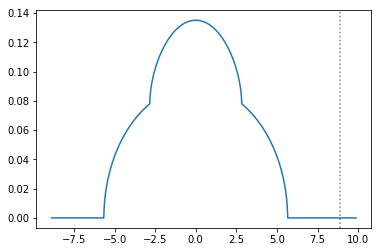

((-im(z)/10 + im((z**2 - 32.0)**0.5)/20 + im((z**2 - 8.0)**0.5)/20)/pi,
 8.872817219230763)

In [2045]:
solve_specrad_diag([10, 10], [0.8, 0.2])

In [ ]:
def solve_specrad_reci(omega, pi, p_reci=0.):
    import sympy as sym
    import matplotlib.pyplot as plt
    from scipy.optimize import fsolve
    def g():
        x, y = sym.symbols('x y')
        expn = (z - (z**2-4*omega[0]*pi[0])**0.5)/(2*omega[0])
        for i in range(1, len(omega)): expn += (z - (z**2-4*omega[i]*pi[i])**0.5)/(2*omega[i])
        return expn
    def foo(x, func, radius): return float(func.subs({'z':x}))-1/radius
    g_z = g()
    print(g_z)
    density = -(sym.im(g_z))/sym.pi
    radius = max([om*p for (om,p) in zip(omega, pi)])
    print(radius)
    radius = fsolve(foo, radius, args=(g_z, radius))[0]
    print(radius)
    def plot_density(density, radius, nbins=1000):
        import numpy as np
        lim=(-radius, radius+1)
        z = np.linspace(lim[0], lim[1], nbins)
        plt.plot(z, [density.subs({'z':i}).evalf() for i in z])
    plot_density(density, radius)
    plt.gca().axvline(radius, ls=':', c='black', alpha=0.5)
    plt.show()
    return density, radius

In [960]:
def solve_specrad_eda(omega, pi, beta=0.):
    import sympy as sym
    import matplotlib.pyplot as plt
    from scipy.optimize import fsolve
    if isinstance(beta, float)or isinstance(beta, int): beta=[beta]*len(omega)
    beta = np.array(beta)
    omega = np.array(omega)-beta
    def g1():
        z, s = sym.symbols('z s')
        expn = (z-beta[0]*s - ((z-beta[0]*s)**2-4*omega[0]*pi[0])**0.5)/(2*omega[0])
        for i in range(1, len(omega)): expn += (z-beta[i]*s - ((z-beta[i]*s)**2-4*omega[i]*pi[i])**0.5)/(2*omega[i])
        expn += -s
        return expn
    def g2():
        z = sym.symbols('z')
        expn = (z-beta[0]/z - ((z-beta[0]/z)**2-4*omega[0]*pi[0])**0.5)/(2*omega[0])
        for i in range(1, len(omega)): expn += (z-beta[i]/z - ((z-beta[i]/z)**2-4*omega[i]*pi[i])**0.5)/(2*omega[i])
        return expn
    def foo(x, func):
        expn = func.subs({'z':x})
        def foo_new(x):
            tmp = expn.subs({'s':x[0]+sym.I*x[1]})
            return np.array([float(sym.re(tmp)), float(sym.im(tmp))])
        return float(abs(fsolve(foo_new, [0, -1])[1]/sym.pi))
    def foo2(x, func, radius): return float(func.subs({'z':x}))-1/radius
    g_z = g1()
    print(g_z)
    #radius = max([om*p for (om,p) in zip(omega, pi)])
    radius = max(np.linalg.eigvalsh((np.diag(omega) + beta[:,np.newaxis]*np.ones((len(omega), len(omega))))*np.array(pi)[:,np.newaxis]))
    print(radius)
    radius = fsolve(foo2, radius, args=(g2(), radius))[0]
    print(radius)
    def plot_density(density, radius, nbins=100):
        import numpy as np
        lim=(0, radius+1)
        z = np.linspace(lim[0], lim[1], nbins)
        z_neg = -z[::-1]
        y = np.array([foo(i, density) for i in z])
        plt.plot(list(z_neg)+list(z), list(y[::-1])+list(y))
    plot_density(g_z, radius)
    plt.gca().axvline(radius, ls=':', c='black', alpha=0.5)
    plt.show()
    return g_z, radius

In [1127]:
sbm_dummy = {'pi':np.array([0.2, 0.2, 0.6]), 'psi':np.diag([10, 16, 22]), 'undirected':True}

183*z/1760 - (z**2 - 52.8)**0.5/44 - (z**2 - 12.8)**0.5/32 - (z**2 - 8.0)**0.5/20
13.2
13.90344039474695


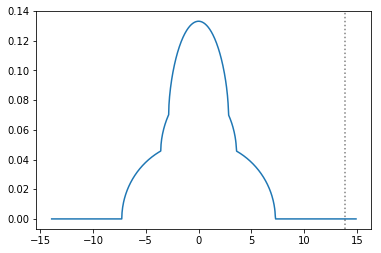

In [953]:
soln_dummy = solve_specrad_diag(np.diag(sbm_dummy['psi']), sbm_dummy['pi'])

eig pi*psi: [ 2.   3.2 13.2]
eig E[adj]: [ 1.82   3.712 12.892]
eig sample: [ 1.84026481  3.73236461 12.93024233]


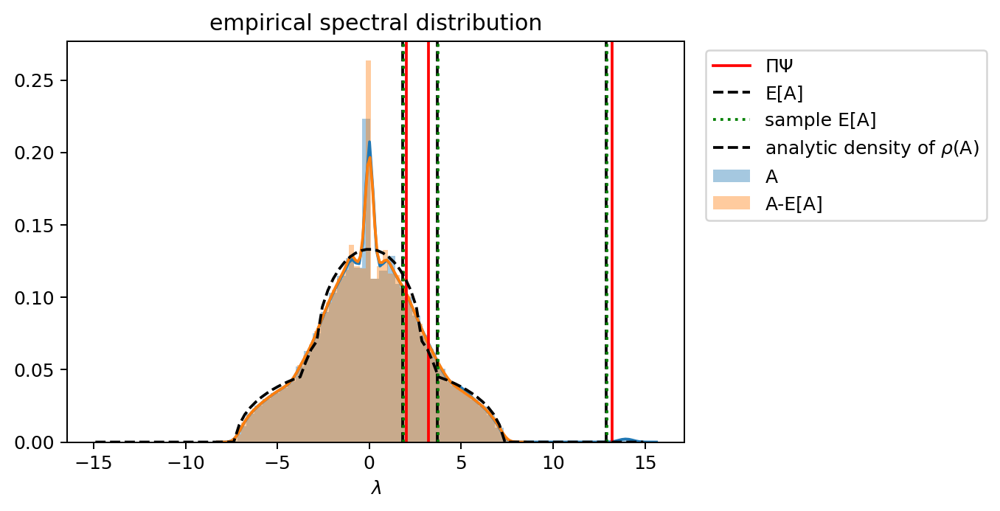

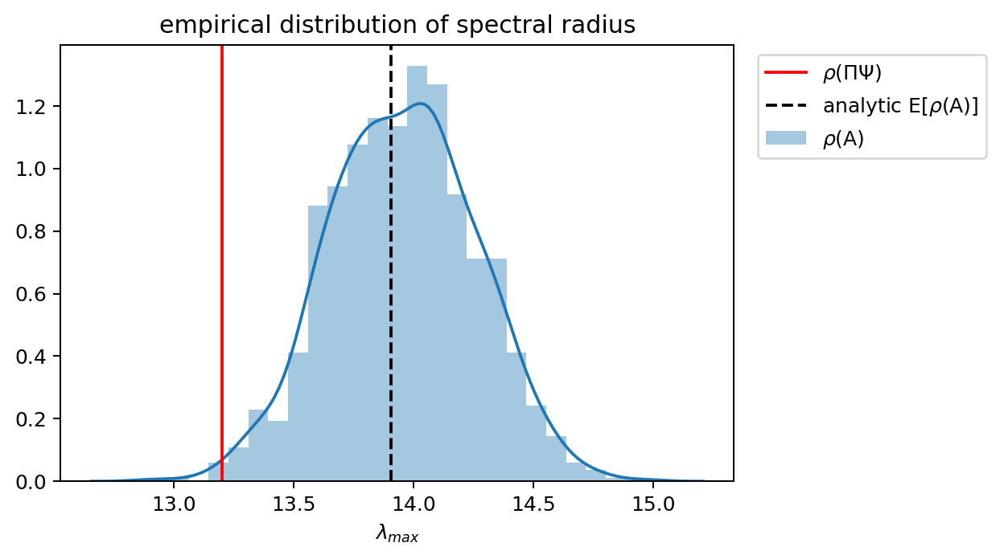

In [958]:
adj_dummy = sample_sbm(sbm_dummy)
eig_adj(adj_dummy, sbm_dummy, density=soln_dummy[0], radius=soln_dummy[1])

In [1149]:
sbm_eda_dummy = {'pi':np.array([0.2, 0.2, 0.6]), 'psi':np.diag([8, 14, 20])+2*np.ones((3,3)), 'undirected':True}

-1.24642857142857*s + 0.123214285714286*z - 0.025*((-2*s + z)**2 - 48.0)**0.5 - 0.0357142857142857*((-2*s + z)**2 - 11.2)**0.5 - 0.0625*((-2*s + z)**2 - 6.4)**0.5
13.47576080060906
14.235536132855446


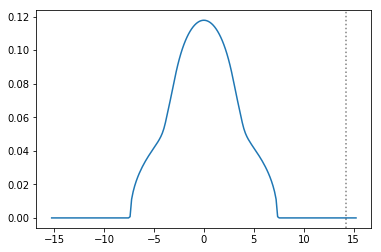

In [956]:
soln_eda_dummy = solve_specrad_eda(np.diag(sbm_eda_dummy['psi']), sbm_eda_dummy['pi'], 2)

eig pi*psi: [ 1.81412076  3.11011844 13.4757608 ]
eig E[adj]: [ 1.85915419  3.24728865 13.29355717]
eig sample: [ 1.88595082  3.2780383  13.31960456]


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:29: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


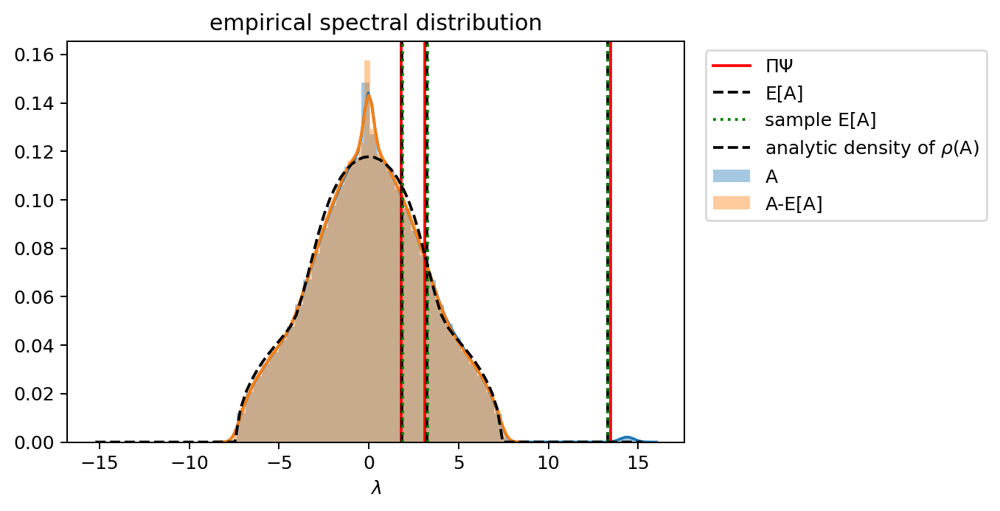

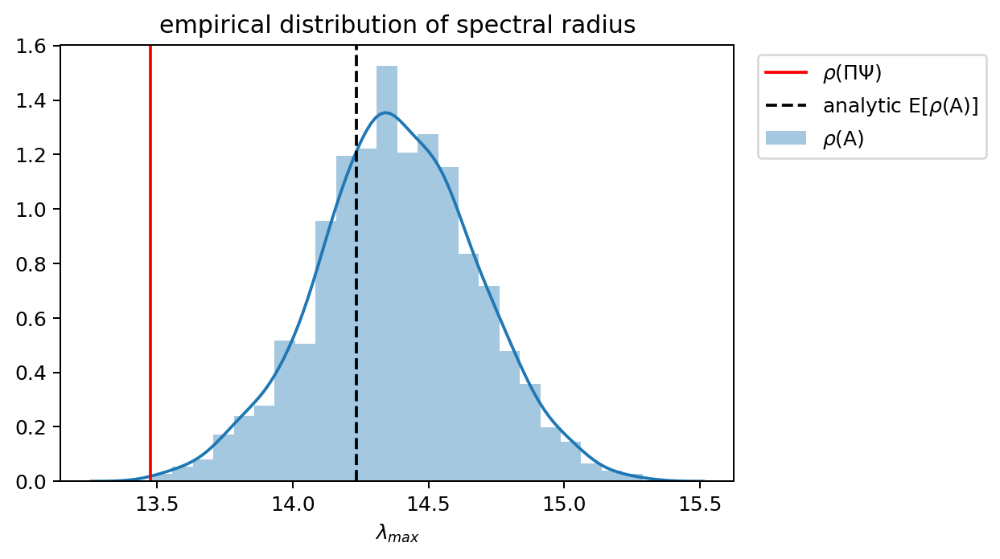

In [1224]:
adj_eda_dummy = sample_sbm(sbm_eda_dummy)
eig_adj(adj_eda_dummy, sbm_eda_dummy, density_eda=soln_eda_dummy[0], radius=soln_eda_dummy[1])

eig pi*psi: [ 1.81412076  3.11011844 13.4757608 ]
eig E[adj]: [ 1.85915419  3.24728865 13.29355717]
eig sample: [ 1.88595082  3.2780383  13.31960456]


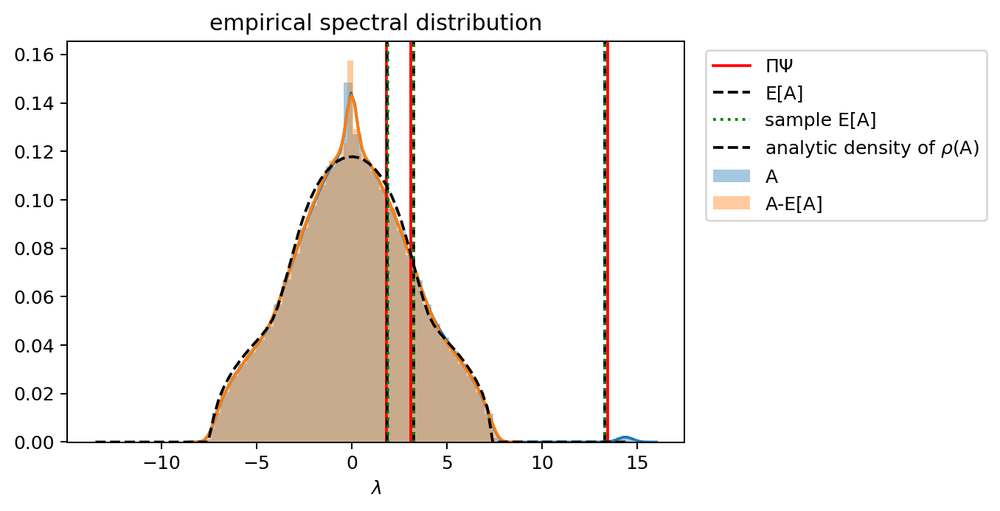

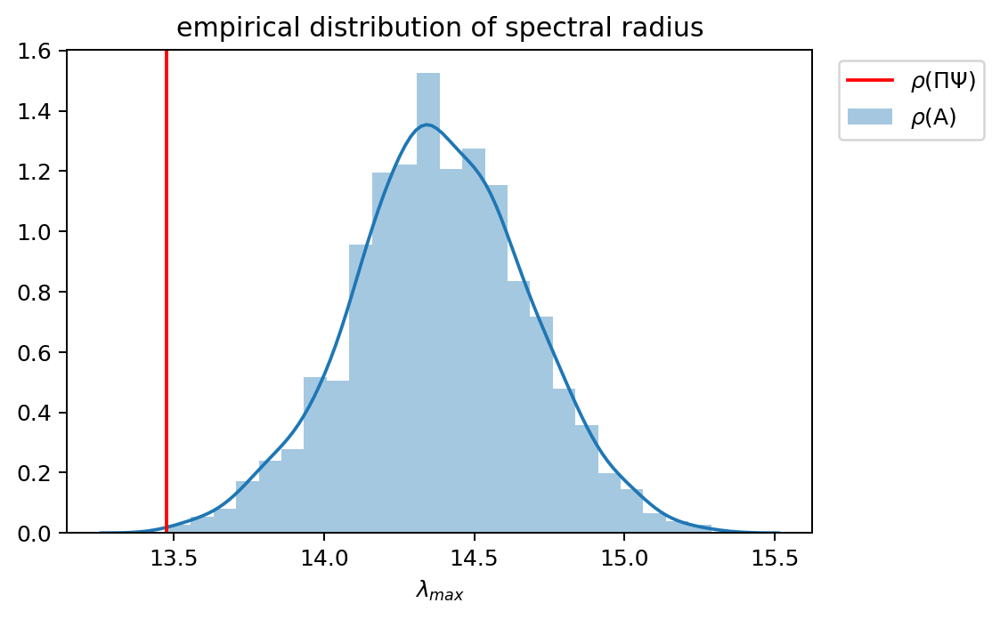

In [1228]:
eig_adj(adj_eda_dummy, sbm_eda_dummy, density=sbm_dum_sol)

In [973]:
sbm_eda_dummy2 = {'pi':np.array([0.2, 0.2, 0.6]), 'psi':np.array([[0, 8, 8], [2, 16, 2], [0, 0, 15]]), 'undirected':True}

-2*s/3 + z/40 - (z**2 - 36.0)**0.5/30 + ((-10*s + z)**2 + 8.0)**0.5/20 - ((-4*s + z)**2 - 9.6)**0.5/24
9.0
9.90074226561092


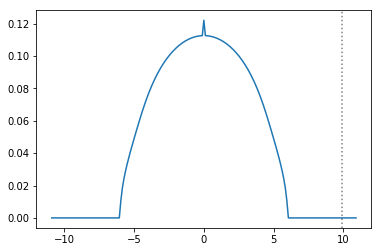

In [974]:
soln_eda_dummy2 = solve_specrad_eda(np.diag(sbm_eda_dummy2['psi']), sbm_eda_dummy2['pi'], [10, 4, 0])

eig pi*psi: [0. 0. 0.]
eig E[adj]: [-1.10303063e-19  1.64771819e-17 -1.64771819e-17]
eig sample: [ 0.08858475  0.09089285 -0.09089285]


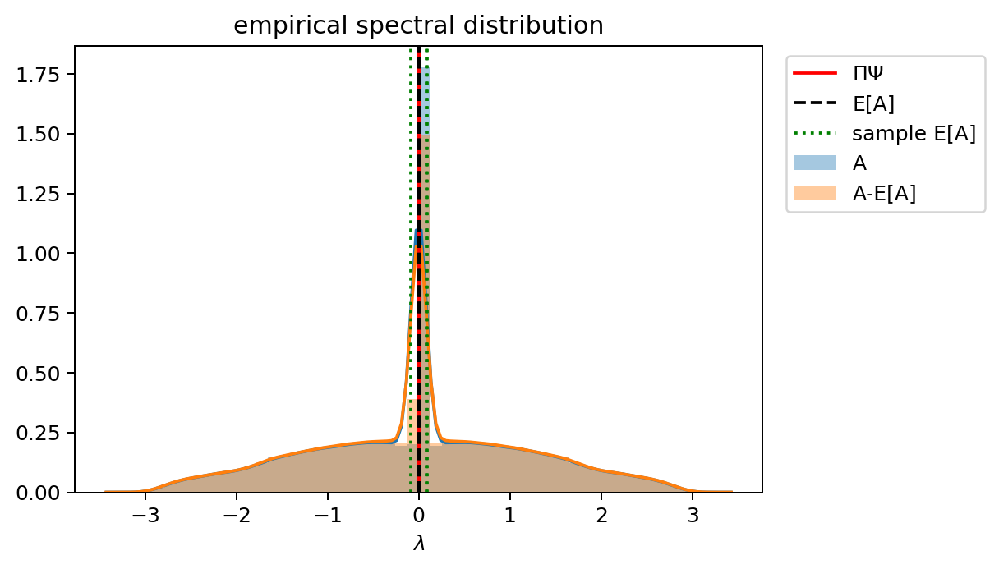

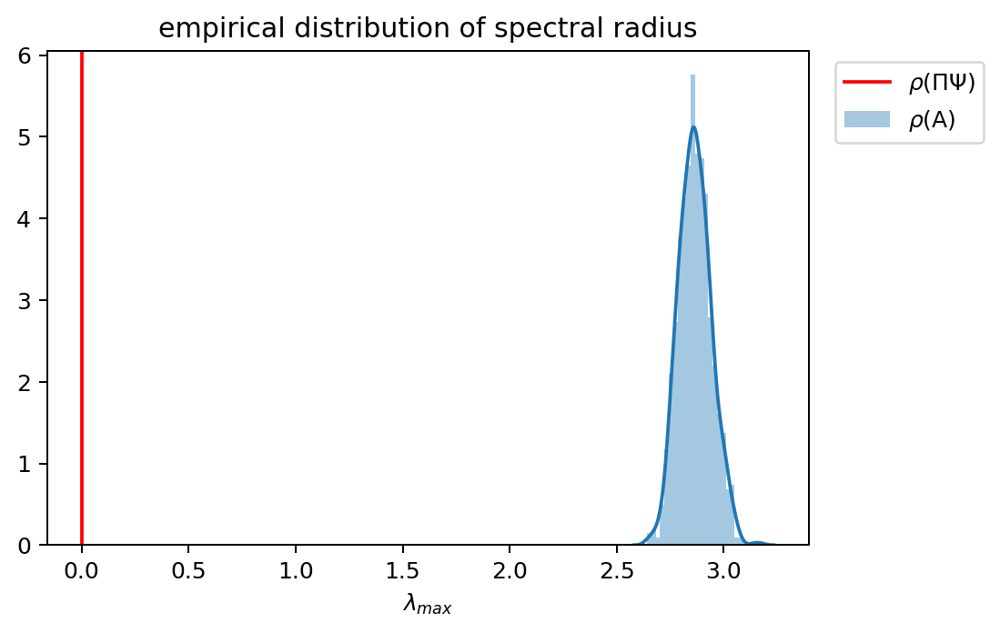

In [977]:
adj_eda_dummy2 = sample_sbm(sbm_eda_dummy2, undirected=False)
eig_adj(adj_eda_dummy2, sbm_eda_dummy2, undirected=False)#, density_eda=soln_eda_dummy2[0], radius=soln_eda_dummy2[1])

In [718]:
def plot_specsol(a=1., lim=(-10,10), z=[-10,-5,5,10], pi=None, nbins=100, scale=0., symmetry=True, random=True, height=4, width=6):
    import numpy as np
    import matplotlib.pyplot as plt
    import warnings
    warnings.filterwarnings('ignore', category=UserWarning)
    if isinstance(a, int) or isinstance(a, float): a = [a]*2
    if isinstance(a, list):
        if isinstance(a[0], list): a = np.array(a)
        else:
            n = len(a)
            if random: a = np.random.rand(n, n)*(np.array(a)[:,np.newaxis])
            else: a = np.ones((n, n))*(np.array(a)[:,np.newaxis])
            if scale: a = a -np.diag(np.diag(a)) + scale*np.diag(a.sum(1)-np.diag(a))
    if not isinstance(z, list): z = [z]
    n = len(a)
    assert(a.shape==(n,n))
    if pi is None: pi = [1/n]*n
    pi = np.array(pi)
    assert(pi.sum(0)==1)
    print('pi:',pi, 'psi:', a)
    
    def foo1(x, z): return np.array([np.dot(p,q) for (p,q) in zip(x.T, np.dot(a, x).T)]) -z*x.sum(0) + 1
    
    def foo2(x, z): return list(x*(np.dot(a, x)-z) + pi[:,np.newaxis])
    
    def foo3(x, z): return (np.array([np.dot(p,q) for (p,q) in zip(x.T, np.dot(a, x).T)]) + 1)/z
    
    #nbins = int(num**(1/n))
    x = [np.linspace(lim[0], lim[1], nbins) for i in range(n)]
    mesh = np.meshgrid(*x, indexing='ij')
    mesh_flat = np.vstack([t.flatten() for t in mesh])
    shape = tuple([nbins]*n)
    if symmetry: plt.figure(figsize=(width*len(z), height), dpi=180)
    else: plt.figure(figsize=(width*len(z), height*n*(n-1)/2), dpi=180)
    for i in range(len(z)):
        flag = z[i]!=0 and n<3
        out1 = foo1(mesh_flat, z[i]).reshape(shape)
        out2 = [t.reshape(shape) for t in foo2(mesh_flat, z[i])]
        if flag: out3 = foo3(mesh_flat, z[i]).reshape(shape)
        for j in range(1, n):
            for k in range(j):
                idx = []
                for u in range(nbins):
                    for v in range(nbins): idx.append(tuple([np.arange(nbins) for t in range(k)] + [u] + [np.arange(nbins) for t in range(j-k-1)] + [v] + [np.arange(nbins) for t in range(n-j-1)]))
                x_toplot = []
                y_toplot = []
                f1_toplot = []
                f2x_toplot = []
                f2y_toplot = []
                f3_toplot = []
                for idx_curr in idx:
                    x_toplot.append(mesh[k][idx_curr])
                    y_toplot.append(mesh[j][idx_curr])
                    f1_toplot.append(out1[idx_curr])
                    f2x_toplot.append(out2[k][idx_curr])
                    f2y_toplot.append(out2[j][idx_curr])
                    if flag: f3_toplot.append(out3[idx_curr])
                x_toplot = np.vstack(x_toplot)
                y_toplot = np.vstack(y_toplot)
                f1_toplot = np.vstack(f1_toplot)
                f2x_toplot = np.vstack(f2x_toplot)
                f2y_toplot = np.vstack(f2y_toplot)
                if flag: f3_toplot = np.vstack(f3_toplot)
                if symmetry: ax = plt.subplot(1, len(z), ((n-1)*k-k*(k-1)/2+j-k-1)*len(z)+i+1)
                else: ax = plt.subplot(n*(n-1)/2, len(z), ((n-1)*k-k*(k-1)/2+j-k-1)*len(z)+i+1)
                ax.set_aspect('equal')
                for u in range(x_toplot.shape[1]):
                    plt.contour(x_toplot[:,u].reshape((nbins, nbins)), y_toplot[:,u].reshape((nbins, nbins)), f1_toplot[:,u].reshape((nbins, nbins)), [0], colors='red', alpha=0.5)
                    plt.contour(x_toplot[:,u].reshape((nbins, nbins)), y_toplot[:,u].reshape((nbins, nbins)), f2x_toplot[:,u].reshape((nbins, nbins)), [0], colors='blue', alpha=0.5)
                    plt.contour(x_toplot[:,u].reshape((nbins, nbins)), y_toplot[:,u].reshape((nbins, nbins)), f2y_toplot[:,u].reshape((nbins, nbins)), [0], colors='green', alpha=0.5)
                if flag:
                    plt.contourf(x_toplot[:,u].reshape((nbins, nbins)), y_toplot[:,u].reshape((nbins, nbins)), f3_toplot[:,u].reshape((nbins, nbins)), cmap='Spectral')
                    cbar = plt.colorbar()
                    if i==len(z)-1: cbar.set_label('g(z)')
                if lim[0]<=0 and lim[1]>=0:
                    plt.gca().axhline(0, ls=':', c='black', alpha=0.5)
                    plt.gca().axvline(0, ls=':', c='black', alpha=0.5)
                plt.xlabel('x'+str(k))
                if i==0: plt.ylabel('x'+str(j))
                if k==0 and j==1: plt.title('z='+str(z[i]))
                if symmetry: break
            if symmetry: break
    plt.show()

pi: [0.5 0.5] psi: [[4 0]
 [0 4]]


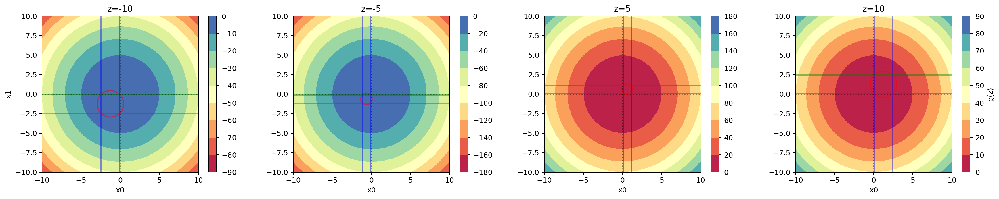

In [713]:
plot_specsol([[4, 0], [0, 4]])

pi: [0.5 0.5] psi: [[4 0]
 [0 4]]


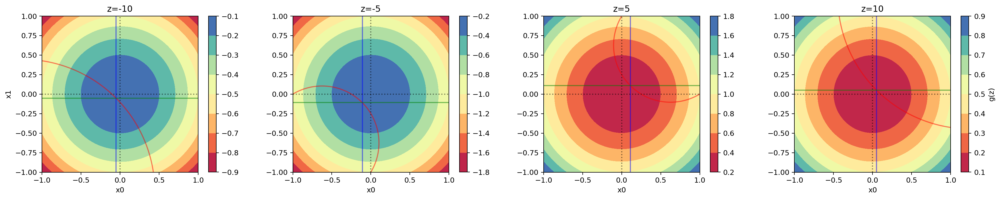

In [715]:
plot_specsol([[4, 0], [0, 4]], lim=(-1,1))

pi: [0.5 0.5] psi: [[4 0]
 [0 8]]


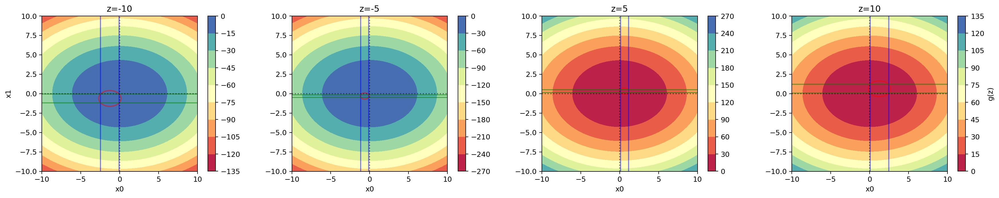

In [714]:
plot_specsol([[4, 0], [0, 8]])

pi: [0.33333333 0.33333333 0.33333333] psi: [[4 0 0]
 [0 4 0]
 [0 0 4]]


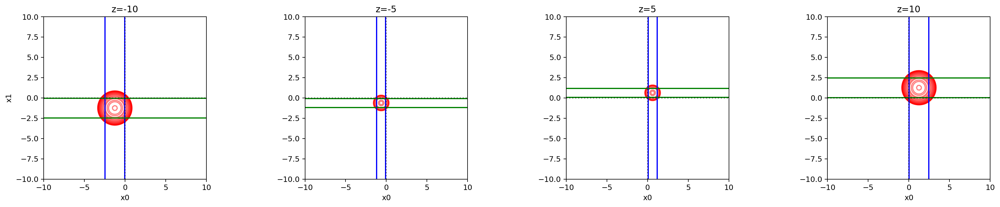

In [694]:
plot_specsol([[4, 0, 0], [0, 4, 0], [0, 0, 4]])

pi: [0.5 0.5] psi: [[4 2]
 [2 4]]


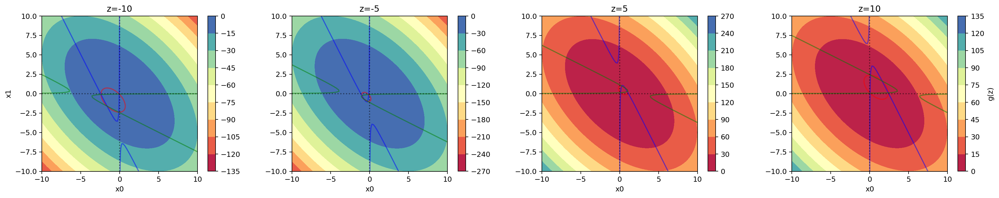

In [695]:
plot_specsol([[4, 2], [2, 4]])

pi: [0.5 0.5] psi: [[4 2]
 [2 4]]


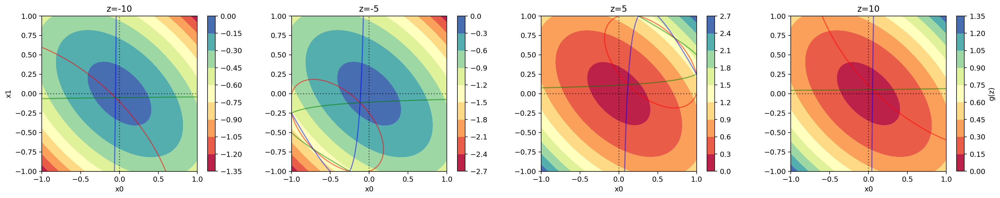

In [716]:
plot_specsol([[4, 2], [2, 4]], lim=(-1,1))

pi: [0.33333333 0.33333333 0.33333333] psi: [[4 2 2]
 [2 4 2]
 [2 2 4]]


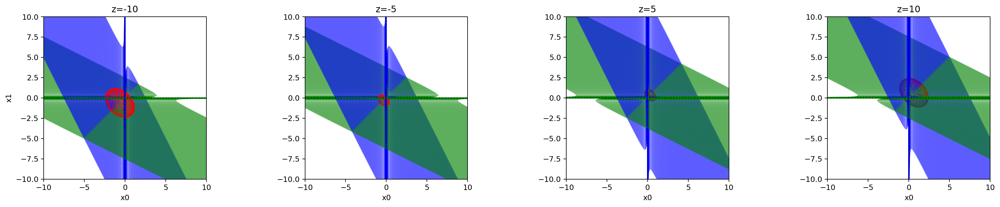

In [696]:
plot_specsol([[4, 2, 2], [2, 4, 2], [2, 2, 4]])

pi: [0.33333333 0.33333333 0.33333333] psi: [[4 2 1]
 [2 4 1]
 [1 1 0]]


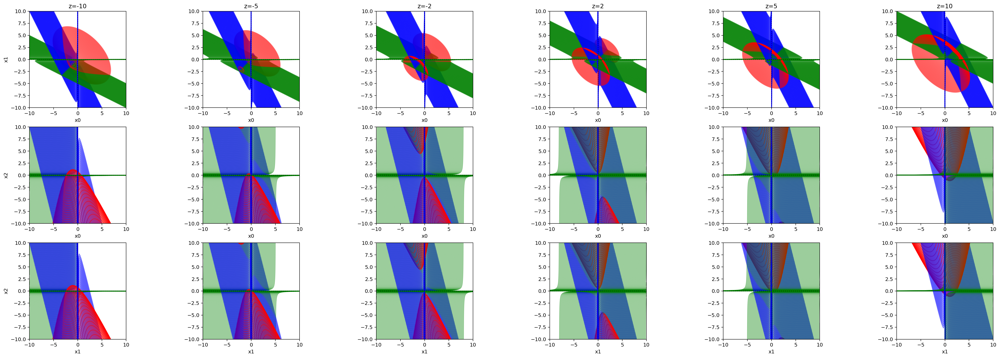

In [724]:
plot_specsol([[4, 2, 1], [2, 4, 1], [1, 1, 0]], z=[-10, -5, -2, 2, 5, 10], symmetry=False)

pi: [0.5 0.5] psi: [[4 4]
 [4 4]]


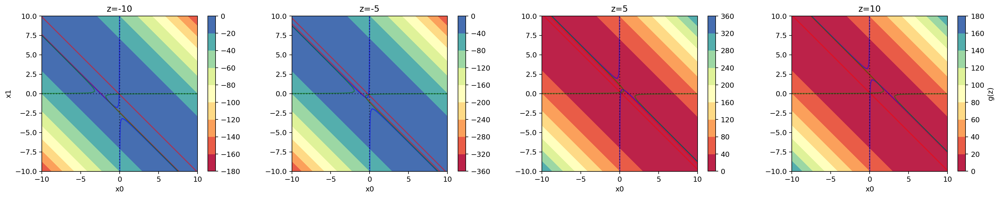

In [697]:
plot_specsol([[4, 4], [4, 4]])

pi: [0.33333333 0.33333333 0.33333333] psi: [[4 4 4]
 [4 4 4]
 [4 4 4]]


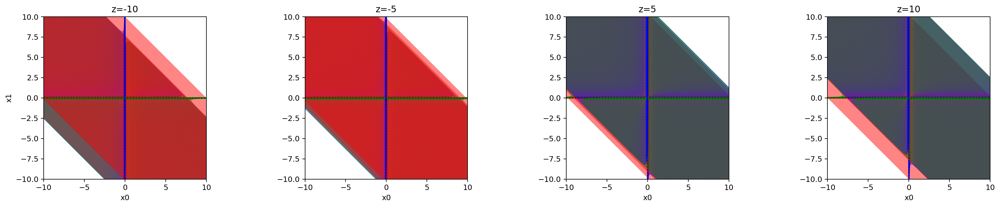

In [698]:
plot_specsol([[4, 4, 4], [4, 4, 4], [4, 4, 4]])

pi: [0.5 0.5] psi: [[4 8]
 [8 4]]


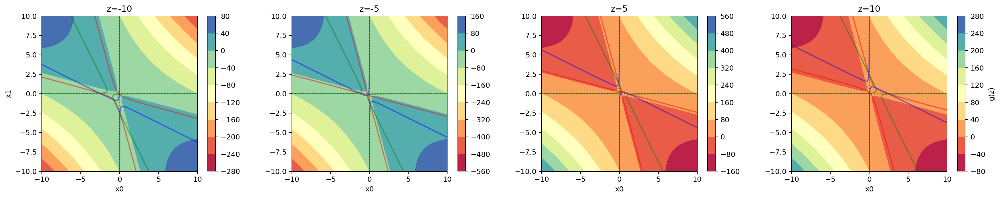

In [699]:
plot_specsol([[4, 8], [8, 4]])

pi: [0.5 0.5] psi: [[4 8]
 [8 4]]


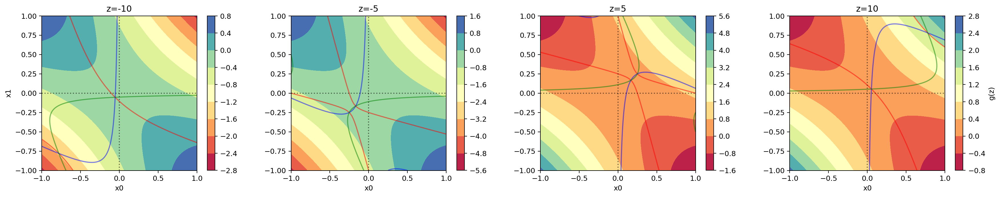

In [721]:
plot_specsol([[4, 8], [8, 4]], lim=(-1,1))

pi: [0.33333333 0.33333333 0.33333333] psi: [[4 8 8]
 [8 4 8]
 [8 8 4]]


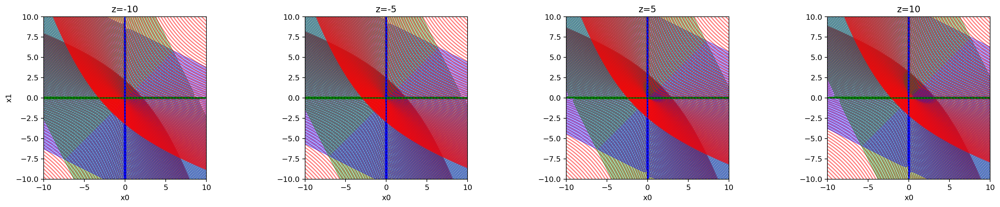

In [700]:
plot_specsol([[4, 8, 8], [8, 4, 8], [8, 8, 4]])

pi: [0.5 0.5] psi: [[0 8]
 [8 0]]


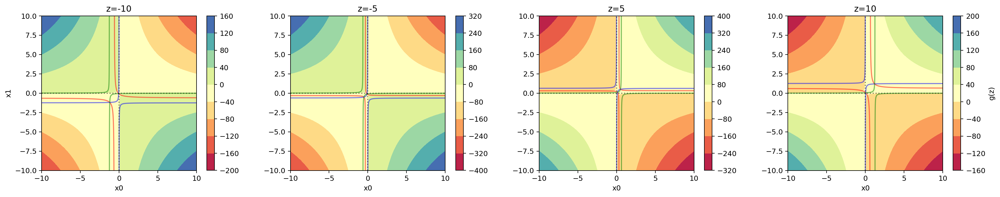

In [701]:
plot_specsol([[0, 8], [8, 0]])

pi: [0.33333333 0.33333333 0.33333333] psi: [[0 8 8]
 [8 0 8]
 [8 8 0]]


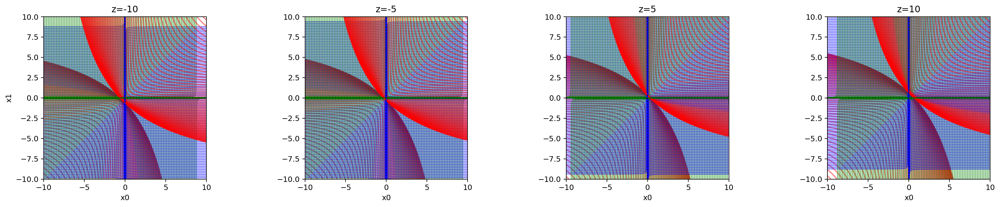

In [702]:
plot_specsol([[0, 8, 8], [8, 0, 8], [8, 8, 0]])

In [411]:
def plot_foo(a, c=None, lim=(-2,2), num=1e10, scale=1.):
    import numpy as np
    import matplotlib.pyplot as plt
    
    if isinstance(a, int): a = [1.]*a
    if isinstance(a, list):
        a = np.random.rand(len(a), len(a))*(np.array(a)[:,np.newaxis])
        if scale: a = a -np.diag(np.diag(a)) + scale*np.diag(a.sum(1)-np.diag(a))
    n = len(a)
    assert(n==a.shape[1])
    print(a)
    nbins = int(num**(0.5/n))
    x = [np.linspace(lim[0], lim[1], nbins) for i in range(n)]
    mesh = np.vstack([t.flatten() for t in np.meshgrid(*x, indexing='ij')])
    def foo(x): return np.dot(a, x) + 1/x
    z = foo(mesh)
    if c is None: c = z[~np.isinf(z)].max()/2
    for i in range(n):
        plt.scatter(mesh[i,:], z[i,:])
        plt.gca().axhline(c, ls='--', c='red')
        plt.xlabel('x'+str(i))
        plt.ylabel('z')
        plt.show()

[[1.6952983  0.3116652  0.49811972 0.88551338]
 [0.13954423 1.8845378  0.79820604 0.94678754]
 [0.70820214 0.27162437 1.13066389 0.15083739]
 [0.48105318 0.76191093 0.89400049 2.13696459]]


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app


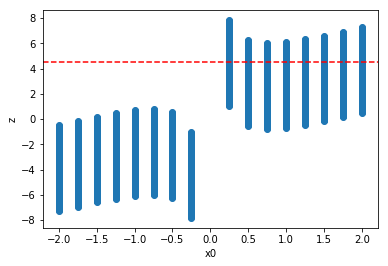

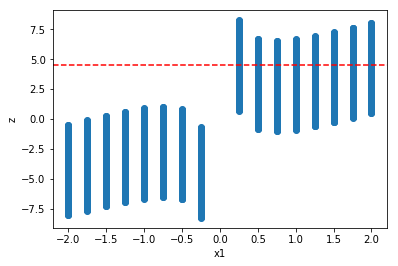

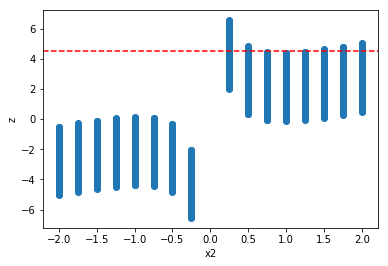

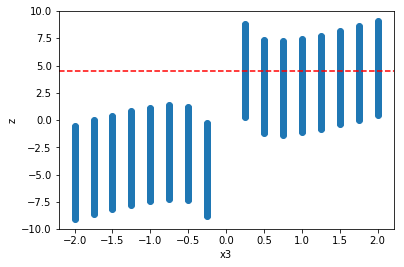

In [261]:
plot_foo(4, scale=1)

In [1208]:
def create_sbm(m=4, kind='homophily', undirected=True, prior=dict()):
    import numpy as np
    from scipy.stats import dirichlet, beta, gamma
    pi_var = 0.001
    if kind=='homophily': rho_mean = 0.5
    else: rho_mean = 0.1
    rho_conc = 4.
    omega_mean = 10.
    omega_var = 1.
    if 'pi' not in prior: prior['pi'] = ((1-1/m)/(pi_var*m)-1)/m
    if 'rho' not in prior: prior['rho'] = (rho_mean*rho_conc, (1-rho_mean)*rho_conc)
    if 'omega' not in prior: prior['omega'] = ((omega_mean/omega_var)**2, omega_mean/omega_var**2)
    if not isinstance(prior['pi'], (list, str)): prior['pi'] = [prior['pi']]*m
    if not isinstance(prior['rho'], list): prior['rho'] = [prior['rho']]*m
    if not isinstance(prior['omega'], list): prior['omega'] = [prior['omega']]*m
    if prior['pi']=='uni': pi = np.ones(m)/m
    else: pi = dirichlet.rvs(prior['pi'])[0]
    self = np.ones(m)
    othr = np.ones(m)
    if (kind=='ambiphily' and undirected) or kind=='perfect_homophily': omega = np.mean([gamma.rvs(omega[0], scale=1/omega[1]) for omega in prior['omega']])*np.ones(m)
    if kind=='perfect_homophily': return {'pi':np.ones(m)/m, 'psi':omega*np.eye(m), 'omega':omega, 'undirected':True}
    else:
        rho = [beta.rvs(rho[0], rho[1]) for rho in prior['rho']]
        if kind=='homophily':
            for i in range(len(rho)):
                self[i] = 1+(1/pi[i]-1)*rho[i]
                othr[i] = 1-rho[i]
        elif kind=='heterophily':
            for i in range(len(rho)):
                self[i] = rho[i]
                othr[i] = (1-pi[i]*rho[i])/(1-pi[i])
        omega = np.array([gamma.rvs(omega[0], scale=1/omega[1]) for omega in prior['omega']])
    psi =  omega[:,np.newaxis]*(np.diag(self-othr)+othr[:,np.newaxis]*np.ones((m,m)))
    if undirected: psi = (psi+psi.transpose())/2
    return {'pi':pi, 'psi':psi, 'omega':omega, 'undirected':undirected}

In [889]:
import numpy as np
sbm_dum = {'pi':np.array([0.6, 0.4]), 'psi':np.array([[16, 8], [10, 12]]), 'undirected':False}
print(np.dot(np.diag(sbm_dum['pi']), sbm_dum['psi']))

[[9.6 4.8]
 [4.  4.8]]


In [1000]:
import numpy as np
sbm_dum = {'pi':np.array([0.5, 0.5]), 'psi':np.array([[22, 10], [2, 14]]), 'undirected':False}
print(np.dot(np.diag(sbm_dum['pi']), sbm_dum['psi']))

[[11.  5.]
 [ 1.  7.]]


In [753]:
sbm_perfect2 = create_sbm(kind='perfect_homophily', m=2, prior={'omega':(22,2)})
print(sbm_perfect2)
sbm_perfect4 = create_sbm(kind='perfect_homophily', m=4, prior={'omega':(44,2)})
print(sbm_perfect4)

{'pi': array([0.5, 0.5]), 'psi': array([[13.26963749,  0.        ],
       [ 0.        , 13.26963749]]), 'omega': array([13.26963749, 13.26963749]), 'undirected': True}
{'pi': array([0.25, 0.25, 0.25, 0.25]), 'psi': array([[23.05331603,  0.        ,  0.        ,  0.        ],
       [ 0.        , 23.05331603,  0.        ,  0.        ],
       [ 0.        ,  0.        , 23.05331603,  0.        ],
       [ 0.        ,  0.        ,  0.        , 23.05331603]]), 'omega': array([23.05331603, 23.05331603, 23.05331603, 23.05331603]), 'undirected': True}


In [6]:
sbm_erg = create_sbm(kind='ambiphily')
print(sbm_erg)

{'pi': array([0.23365811, 0.26868888, 0.22317452, 0.27447849]), 'psi': array([[5.58093467, 5.58093467, 5.58093467, 5.58093467],
       [5.58093467, 5.58093467, 5.58093467, 5.58093467],
       [5.58093467, 5.58093467, 5.58093467, 5.58093467],
       [5.58093467, 5.58093467, 5.58093467, 5.58093467]]), 'omega': array([5.58093467, 5.58093467, 5.58093467, 5.58093467]), 'undirected': True}


In [7]:
sbm_amb = create_sbm(kind='ambiphily', prior={'omega':(4.,1.)}, undirected=False)
print(sbm_amb)

{'pi': array([0.25058066, 0.24750395, 0.30667562, 0.19523976]), 'psi': array([[2.03017569, 2.03017569, 2.03017569, 2.03017569],
       [4.14971905, 4.14971905, 4.14971905, 4.14971905],
       [0.9156567 , 0.9156567 , 0.9156567 , 0.9156567 ],
       [3.04229718, 3.04229718, 3.04229718, 3.04229718]]), 'omega': array([2.03017569, 4.14971905, 0.9156567 , 3.04229718]), 'undirected': False}


In [1895]:
sbm_hom = create_sbm(undirected=False)
print(sbm_hom)

{'pi': array([0.2537188 , 0.26129603, 0.23308571, 0.25189947]), 'psi': array([[14.47705953,  7.27398935,  7.27398935,  7.27398935],
       [ 4.36651708, 26.76205106,  4.36651708,  4.36651708],
       [ 9.33910255,  9.33910255, 10.89197928,  9.33910255],
       [ 5.08118345,  5.08118345,  5.08118345, 26.66178807]]), 'omega': array([ 9.10154367, 10.21838111,  9.70105592, 10.51732626]), 'undirected': False}


In [1210]:
sbm_het = create_sbm(kind='heterophily')
print(sbm_het)

{'pi': array([0.28099669, 0.22860865, 0.22474789, 0.26564677]), 'psi': array([[ 5.92971982,  9.28434489, 10.26065626,  9.3007514 ],
       [ 9.28434489,  4.47895407, 10.82154049,  9.86163563],
       [10.26065626, 10.82154049,  4.28935325, 10.837947  ],
       [ 9.3007514 ,  9.86163563, 10.837947  ,  6.350515  ]]), 'omega': array([ 7.93842874,  8.61845222, 10.11033263,  8.94096594]), 'undirected': True}


In [10]:
def sample_sbm(sbm, p_reciprocate=1., n=1000, num=250, single=True, random_pi=False, shuffle=False, self=True, plot=False):
    
    import numpy as np
    if p_reciprocate=='auto':
        psi = sbm['psi']
        pi = sbm['pi']
        p_reciprocate = np.dot(psi, pi)/np.dot(psi.T, pi)
        p_reciprocate[p_reciprocate>1] = 1.
        print('using p_reciprocate', p_reciprocate)
            
    def get_prob(sbm, p_reci):
        factor = 1/n
        if random_pi: people = np.random.multinomial(1, sbm['pi'], n)
        else: people = np.vstack([np.hstack([np.zeros((i,1)) for k in range(j)] + [np.ones((i,1))] + [np.zeros((i,1)) for k in range(j+1, len(sbm['pi']))]) for i,j in zip(np.array(n*sbm['pi'], dtype=int), range(len(sbm['pi'])))])
        if shuffle: np.random.shuffle(people)
        keep = people.sum(axis=0)>0
        people = people[:,keep]
        psi = sbm['psi'][keep,:][:,keep]
        p = np.matmul(np.matmul(people, factor*psi), people.transpose())
        p[p>1] = 1.
        if not self: np.fill_diagonal(p, 0)
        if not (isinstance(p_reci, float) or isinstance(p_reci, int)):
            p_r = np.tile(np.dot(people, p_reci), (people.shape[0], 1)).T
            return p, p_r
        else: return p, p_reci
    
    def get_bernoulli(p=1.):
        if isinstance(p, float) or isinstance(p, int): return np.random.binomial(1, p, (n, n))
        else: return np.random.binomial(1, p)
    
    if single: p, p_reciprocate = get_prob(sbm, p_reciprocate)
    if n!=p.shape[0]:
        n = p.shape[0]
        print('number of people slightly reduced to %i'%n)
    adj = []
    for i in range(num):
        if not single: p, p_reciprocate = get_prob(sbm, p_reciprocate)
        proposal = np.triu(get_bernoulli(0.5))
        proposal = proposal + np.tril(np.ones((n, n))) - proposal.T
        proposal_sent = proposal*np.random.binomial(1, p)
        proposal_accepted = proposal_sent.T*get_bernoulli(p_reciprocate)
        a = proposal_sent + proposal_accepted
        adj.append(a)
    if plot:
        import matplotlib.pyplot as plt
        import seaborn as sns
        sns.heatmap(np.dstack(adj).mean(-1), square=True)
        plt.show()
    return {'adj':adj, 'p':(p+p_reciprocate*p.T)/2, 'p_reciprocate':p_reciprocate}

using p_reciprocate [1.         0.83109214 1.         0.88534132]
number of people slightly reduced to 998


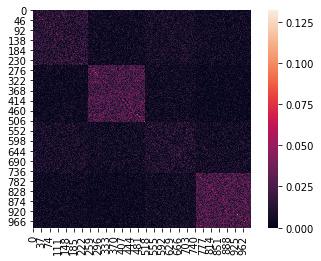

In [1944]:
adj_hom = sample_sbm(sbm_hom, p_reciprocate='auto', plot=True)

In [1001]:
adj_dum = sample_sbm(sbm_dum, undirected=False)

In [19]:
adj_erg = sample_sbm(sbm_erg)

In [1220]:
adj_hom = sample_sbm(sbm_hom)

In [1221]:
adj_het = sample_sbm(sbm_het)

In [15]:
def solve_2sbm(params={}, verbose=False):
    import sympy as sym
    
    def solve_quartic():
        a, b, c, d, e, x = sym.symbols('a b c d e x')
        return sym.solveset(a*x**4+b*x**3+c*x**2+d*x+e, x, domain=sym.S.Complexes)

    def solve_cubic():
        a, b, c, d, x = sym.symbols('a b c d x')
        return sym.solveset(a*x**3+b*x**2+c*x+d, x, domain=sym.S.Complexes)
    
    def solve_quadratic():
        a, b, c, x = sym.symbols('a b c x')
        return sym.solveset(a*x**2+b*x+c, x, domain=sym.S.Complexes)

    z, x = sym.symbols('z x')
    if params: a, b, c, d = tuple([params[key] for key in 'abcd'])
    else: a, b, c, d = sym.symbols('a b c d')
    f4 = b*c*d-a*d**2
    f3 = z*(2*a*d-b*c-c*d)
    f2 = z**2*(c-a)+b*c-c**2-2*a*d
    f1 = z*(2*a-c)
    f0 = -a
    if verbose: print('coeffs:', ', '.join(map(str, [f4, f3, f2, f1, f0])))
    if f4==0:
        if f3==0:
            tmp = solve_quadratic()
            h2 = [y for y in tmp.subs({'a':f2, 'b':f1, 'c':f0})]
        else:
            tmp = solve_cubic()
            h2 = [y for y in tmp.subs({'a':f3, 'b':f2, 'c':f1, 'd':f0})]
    else:
        tmp = solve_quartic()
        h2 = [y.simplify() for y in tmp.subs({'a':f4, 'b':f3, 'c':f2, 'd':f1, 'e':f0})]
    h1 = [((z-d*y-1/y)/c).simplify() for y in h2]
    eig = (a+d+sym.sqrt((a+d)**2-4*(a*d-b*c)))/2
    if verbose: print('eig:', eig)
    z_s = [(eig*(a*x**2+(b+c)*x*y+d*y**2+1)-z).simplify() for (x,y) in zip(h1, h2)]
    return [tuple([x.evalf() for x in sym.solve(t)[0].as_real_imag()]) for t in z_s]

In [7]:
def eig_adj(adj, sbm, density=None):
    import numpy as np    
    import seaborn as sns
    import matplotlib.pyplot as plt
    
    def comp2real(x): return np.hstack([np.real(x)[:,np.newaxis], np.imag(x)[:,np.newaxis]])
    
    p_reciprocate = adj['p_reciprocate']
    psi = (sbm['psi'] + p_reciprocate*sbm['psi'].T)/2
    pi = sbm['pi']
    mat = (pi[:,np.newaxis]**0.5)*psi*(pi[np.newaxis,:]**0.5)
    
    if p_reciprocate==1:
        eig = [np.linalg.eigvalsh(a) for a in adj['adj']]
        eig_rad = np.array([np.max(e) for e in eig])
        eig = np.concatenate(eig)[:,np.newaxis]
        eig_ctr = np.concatenate([np.linalg.eigvalsh(a-adj['p']) for a in adj['adj']])[:,np.newaxis]
        eig_mu_emp = np.linalg.eigvalsh(np.dstack(adj['adj']).mean(-1))[:,np.newaxis]
        eig_mu = np.linalg.eigvalsh(adj['p'])[:,np.newaxis]
        eig_sbm = np.linalg.eigvalsh(mat)[:,np.newaxis]
        labels = ['$\\lambda$']
    else:
        eig = [comp2real(np.linalg.eigvals(a)) for a in adj['adj']]
        eig_rad = np.array([np.max(e[:,0]) for e in eig])
        eig = np.vstack(eig)
        eig_ctr = np.vstack([comp2real(np.linalg.eigvals(a-adj['p'])) for a in adj['adj']])
        eig_mu_emp = comp2real(np.linalg.eigvals(np.dstack(adj['adj']).mean(-1)))
        eig_mu = comp2real(np.linalg.eigvals(adj['p']))
        eig_sbm = comp2real(np.linalg.eigvals(mat))
        labels = ['re($\\lambda$)', 'im($\\lambda$)']
    
    for i in range(eig.shape[1]):
        plt.figure(dpi=180)
        sns.distplot(eig[:,i], label='A')
        sns.distplot(eig_ctr[:,i], label='A-E[A]')
        plt.gca().axvline(eig_sbm[0,i], ls='-', c='red', label='$\\Pi\\Psi$')
        for j in eig_sbm[1:,i]: plt.gca().axvline(j, ls='-', c='red')
        idx = np.argsort(np.abs(eig_mu[:,i]))[-len(eig_sbm):]
        eig_mu_i = eig_mu[idx,i]
        plt.gca().axvline(eig_mu_i[0], ls='--', c='black', label='E[A]')
        for j in eig_mu_i[1:]: plt.gca().axvline(j, ls='--', c='black')
        idx = np.argsort(np.abs(eig_mu_emp[:,i]))[-len(eig_sbm):]
        eig_mu_emp_i = eig_mu_emp[idx,i]
        plt.gca().axvline(eig_mu_emp_i[0], ls=':', c='green', label='sample E[A]')
        for j in eig_mu_emp_i[1:]: plt.gca().axvline(j, ls=':', c='green')
        print('eig pi*psi:', np.sort(eig_sbm[:,i]))
        print('eig E[adj]:', eig_mu_i)
        print('eig sample:', eig_mu_emp_i)
        if density is not None: plt.plot(density[0], density[1], ls='--', c='black', label='analytic density of '+labels[i])
        plt.title('empirical spectral distribution')
        plt.xlabel(labels[i])
        plt.legend(bbox_to_anchor=(1.02, 1.0), loc='upper left')
        plt.show()
        
    plt.figure(dpi=180)
    sns.distplot(eig_rad, label='$\\rho$(A)')
    plt.gca().axvline(np.max(eig_sbm[:,0]), ls='-', c='red', label='$\\rho(\\Pi\\Psi)$')
    if density is not None: plt.gca().axvline(density[-1], ls='--', c='black', label='analytic E[$\\rho$(A)]')
    plt.title('empirical distribution of spectral radius')
    plt.xlabel('$\\lambda_{max}$')
    plt.legend(bbox_to_anchor=(1.02, 1.0), loc='upper left')
    plt.show()

In [1707]:
def eig_lap(adj, sbm=None, undirected=True, density=None, density_eda=None, radius=False, homophily=0):
    import numpy as np    
    import seaborn as sns
    import matplotlib.pyplot as plt
    
    def comp2real(x):
        return np.real(x)
        idx = np.real(x)<0
        x = np.abs(x)
        x[idx] = -x[idx]
        return x   
    
    def plot_density_dia(density, radius, nbins=100):
        lim=(-radius-1, radius+1)
        z = np.linspace(lim[0], lim[1], nbins)
        return list(z), [density.subs({'z':i}).evalf() for i in z]
    
    def plot_density_eda(density, radius, nbins=100):
        import sympy as sym
        from scipy.optimize import fsolve
        def foo(x, func):
            expn = func.subs({'z':x})
            def foo_new(x):
                tmp = expn.subs({'s':x[0]+sym.I*x[1]})
                return np.array([float(sym.re(tmp)), float(sym.im(tmp))])
            return float(abs(fsolve(foo_new, [0, -1])[1]/sym.pi))
        lim=(0, radius+1)
        z = np.linspace(lim[0], lim[1], nbins/2)
        y = np.array([foo(i, density) for i in z])
        return list(-z[::-1])+list(z), list(y[::-1])+list(y)
    
    if undirected:
        eig = [np.linalg.eigvalsh(np.diag(a.sum(1))-a) for a in adj['adj']]
        eig_fie = np.array([np.sort(e)[1] for e in eig])
        eig = np.concatenate(eig)
        lap_mu = np.diag(adj['p'].sum(1)) - adj['p']
        eig_ctr = np.concatenate([np.linalg.eigvalsh(np.diag(a.sum(1))-a-lap_mu) for a in adj['adj']])
        adj_mu = np.dstack(adj['adj']).mean(-1)
        eig_mu_emp = np.linalg.eigvalsh(np.diag(adj_mu.sum(1))-adj_mu)
        eig_mu = np.linalg.eigvalsh(lap_mu)
    else: return
    plt.figure(dpi=180)
    sns.distplot(eig, label='L')
    sns.distplot(eig_ctr, label='L-E[L]')
    eig_sbm = None
    if sbm is not None:
        lap = np.diag((1/sbm['pi']) * np.dot(sbm['psi'], sbm['pi'])) - sbm['psi']
        mat = (sbm['pi'][:,np.newaxis]**0.5)*lap*(sbm['pi'][np.newaxis,:]**0.5)
        if sbm['undirected']: eig_sbm = np.linalg.eigvalsh(mat)
        else: eig_sbm = comp2real(np.linalg.eigvals(mat))
        eig_sbm = eig_sbm[np.argsort(np.abs(eig_sbm))]
        plt.gca().axvline(eig_sbm[0], ls='-', c='red', label='$\\Pi\\mathcal{L}$')
        for i in eig_sbm[1:]: plt.gca().axvline(i, ls='-', c='red')
        idx = np.argsort(np.abs(eig_mu))[:len(eig_sbm)]
        eig_mu = eig_mu[idx]
        plt.gca().axvline(eig_mu[0], ls='--', c='black', label='E[L]')
        for i in eig_mu[1:]: plt.gca().axvline(i, ls='--', c='black')
        idx = np.argsort(np.abs(eig_mu_emp))[:len(eig_sbm)]
        eig_mu_emp = eig_mu_emp[idx]
        plt.gca().axvline(eig_mu_emp[0], ls=':', c='green', label='sample E[L]')
        for i in eig_mu_emp[1:]: plt.gca().axvline(i, ls=':', c='green')
        print('eig pi*lap:', eig_sbm)
        print('eig E[lap]:', eig_mu)
        print('eig sample:', eig_mu_emp)
        if density is not None:
            if isinstance(density, tuple): plt.plot(density[0], density[1], ls='--', c='black', label='analytic density of $\\rho$(L)')
            else:
                z, analytic_density = plot_density_dia(density, radius)
                plt.plot(z, analytic_density, ls='--', c='black', label='analytic density of $\\rho$(L)')
        elif density_eda is not None:            
            z, analytic_density = plot_density_eda(density_eda, radius)
            plt.plot(z, analytic_density, ls='--', c='black', label='analytic density of $\\rho$(L)')
    plt.title('empirical spectral distribution')
    plt.xlabel('$\\lambda$')
    plt.legend(bbox_to_anchor=(1.02, 1.0), loc='upper left')
    plt.show()
    plt.figure(dpi=180)
    sns.distplot(eig_fie, label='$\\phi$(L)')
    if eig_sbm is not None:
        plt.gca().axvline(eig_sbm[-1], ls='-', c='red', label='$\\rho(\\Pi\\mathcal{L})$')
        if density is None and density_eda is None:
            if homophily: plt.gca().axvline(homophily+1, ls='--', c='black', label='analytic E[$\\rho$(L)]')
            else:
                if radius and len(mat)==2:
                    mat = np.around(mat, 2)
                    eig_max = solve_2sbm({'a':mat[0][0],'b':mat[0][1],'c':mat[1][0],'d':mat[1][1]}, verbose=True)
                    for e in eig_max:
                        if e[1]==0:
                            print('analytic fiedler value:', e[0])
                            plt.gca().axvline(e[0], ls='--', c='black', label='analytic E[$\\phi$(L)]')
        else:
            if radius: plt.gca().axvline(radius, ls='--', c='black', label='analytic E[$\\phi$(L)]')
    plt.title('empirical distribution of fiedler value')
    plt.xlabel('$\\phi$')
    plt.legend(bbox_to_anchor=(1.02, 1.0), loc='upper left')
    plt.show()

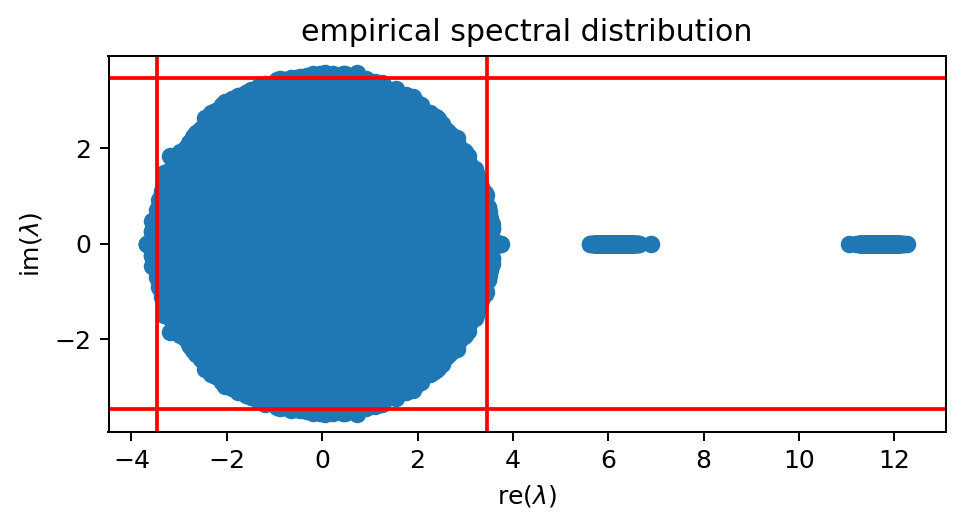

In [1013]:
eig_adj(adj_dum, sbm_dum, undirected=False)

In [25]:
def solve_sbm(params={}, verbose=False):
    from sympy import solve_poly_system, symbols, sqrt, nonlinsolve
    from sympy.solvers.polysys import solve_triangulated
    x, y, z = symbols('x y z')
    if params: a, b, c, d = tuple([params[key] for key in 'abcd'])
    else: a, b, c, d = symbols('a b c d')
    eig = (a+d+sqrt((a+d)**2-4*(a*d-b*c)))/2
    if verbose: print('eig:', eig)
    eqns = [x*(z-a*x-b*y)-1, y*(z-c*x-d*y)-1, eig*(a*x**2+(b+c)*x*y+d*y**2+1)-z]
    if verbose:
        print('equations:')
        for eqn in eqns: print('\t'+str(eqn.evalf()))
    solution = nonlinsolve(eqns, x, y, z)
    out = dict()
    for vals, var in zip(solution, 'xyz'): out[var] = [val.evalf() for val in vals]
    if verbose:
        for i in range(len(out['z'])):
            vals = {var: out[var][i] for var in out}
            print('at', vals)
            for eqn in eqns: print('\tequation:', eqn, '=', eqn.subs(vals).evalf())
    return out

eig pi*psi: [2.17514121 2.63728783 3.54436695 9.49343417]
eig E[adj]: [2.13231765 2.66669094 3.42290641 9.55617104]
eig sample: [2.17752558 2.70897392 3.45451407 9.58816595]


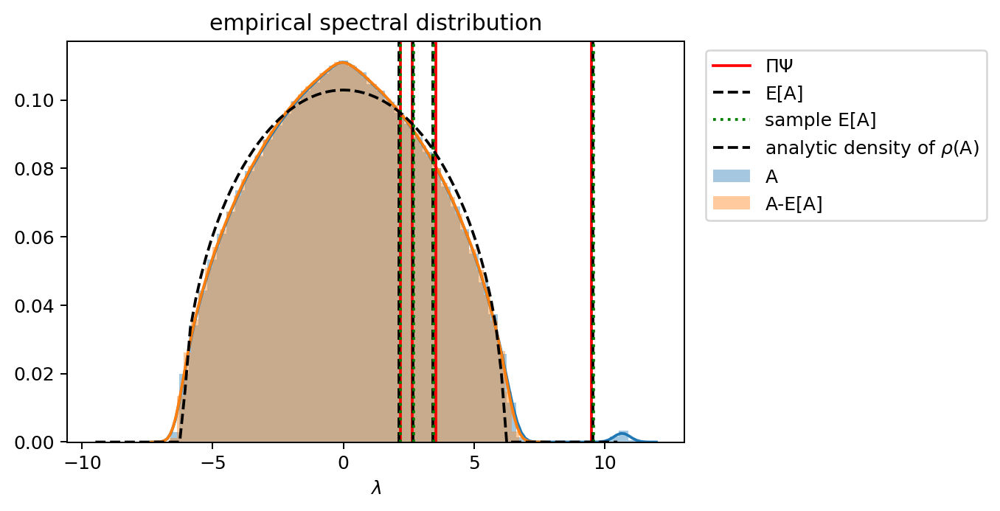

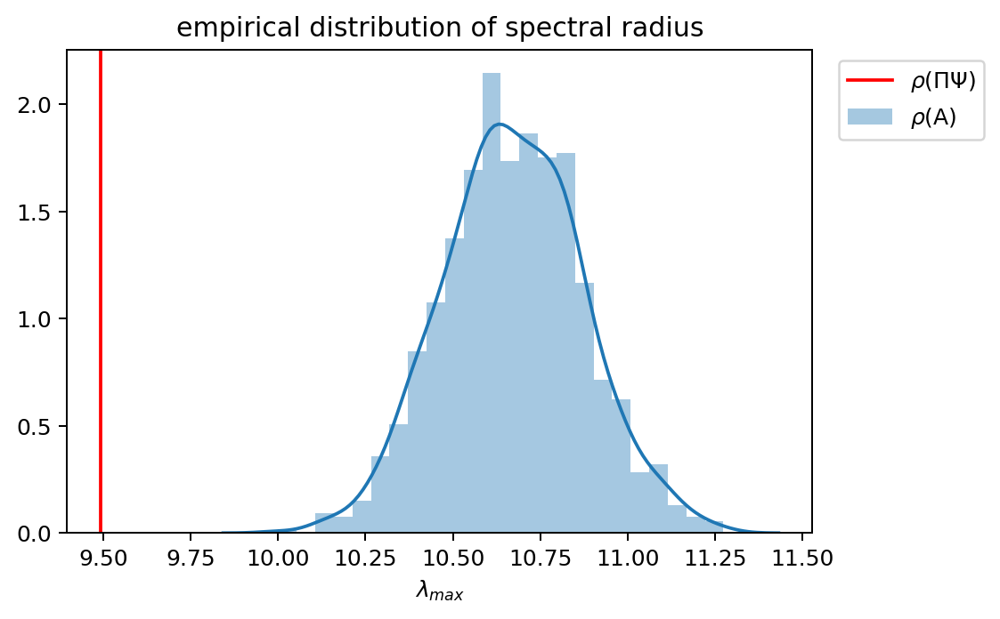

In [1222]:
eig_adj(adj_hom, sbm_hom, density=sbm_hom_sol)

eig pi*psi: [-0.56529363 -1.27295786 -1.60050494  8.77993261]
eig E[adj]: [-0.85269804 -1.10771514 -1.53954524  8.81883258]
eig sample: [-0.85368025 -1.11217175 -1.52597884  8.8216513 ]


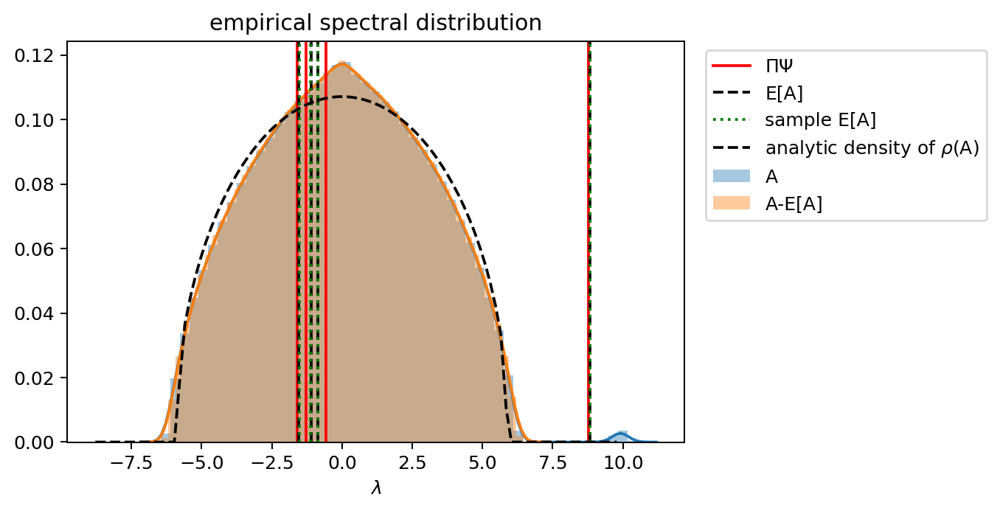

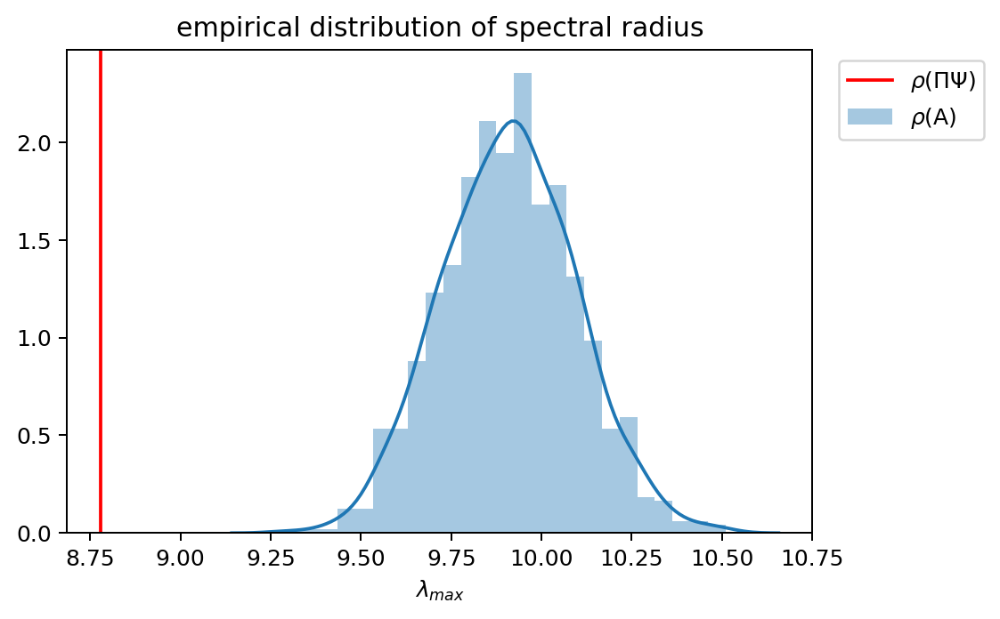

In [1223]:
eig_adj(adj_het, sbm_het, density=sbm_het_sol)